In [1]:
%pylab inline
from scipy.integrate import solve_ivp
from IPython import display
import time
import scipy.integrate as integrate
from scipy.optimize import curve_fit
import seaborn as sb

Populating the interactive namespace from numpy and matplotlib


### Initializations

In [5]:
# the 1D space
length = 30.0
Lmax = length
Lmin = -length
dx = 0.1
Nx = int((Lmax-Lmin)/dx) +1
xs = linspace(Lmin, Lmax, Nx)

# will be used to determine atot (atot = N) when only D is specified  
# and used to determine D (D = atot/N) when only atot is specified
N = 100.0 

# the diffusion coefficients
Ds = logspace(-4,-2,15,base=10)
D_n = len(Ds)

nus = logspace(-2,0,15,base = 10)
nu_n = len(nus)

dt = 0.001
tf = 100.0 #each run goes for (tf/dt) steps 
run_n = 30 # number of runs

print(nus,Ds)

[0.01       0.01389495 0.01930698 0.02682696 0.03727594 0.05179475
 0.07196857 0.1        0.13894955 0.19306977 0.26826958 0.37275937
 0.51794747 0.71968567 1.        ] [0.0001     0.00013895 0.00019307 0.00026827 0.00037276 0.00051795
 0.00071969 0.001      0.0013895  0.0019307  0.0026827  0.00372759
 0.00517947 0.00719686 0.01      ]


### Biased initial substrate 
#### efficiency vs. D (a0 = 1/sigma)

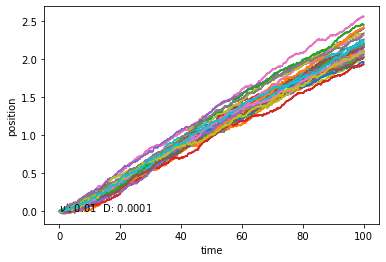

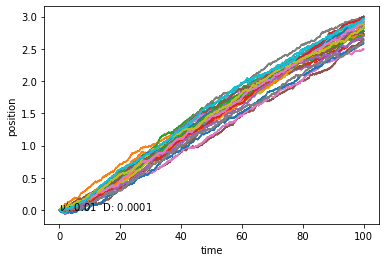

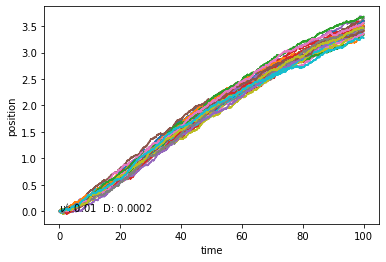

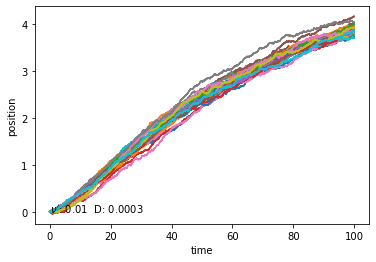

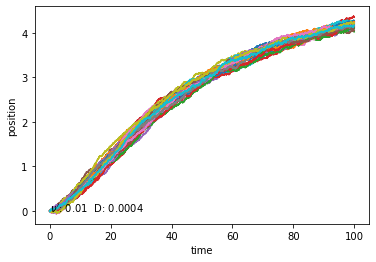

...

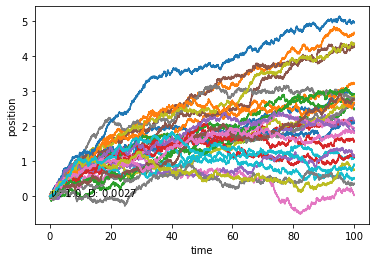

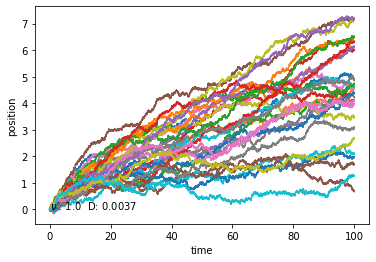

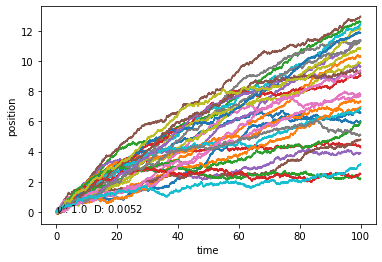

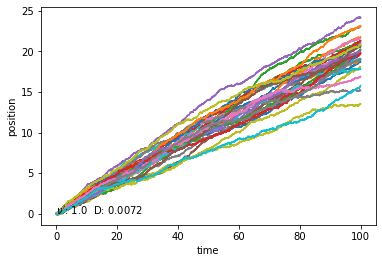

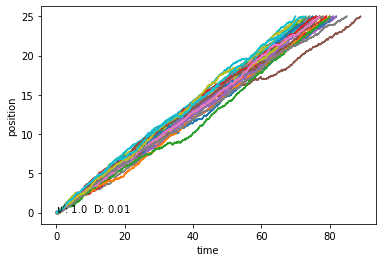

In [6]:
sol_0Db = []
for nu in nus:
    sol_1 = []
    for D in Ds: 
        sol_2 = []
        for run in range(run_n):
            xp = 0.0
            Ac = zeros(Nx) #initialize bound complex

            #intialize substrate
            As = zeros(Nx) 
            As[xs > 0.0] = linspace(0.1,length,int(Lmax/dx)) * N/2.0 # create initial gradient with slope (a0/2.0)
            As[xs > 2.0] = N # biased to the right

            # some values to save for each time step
            xp_t = [] # position
            v_t = [] # times
            burn_t = [] # burn rate

            noisescale = sqrt(2*dt*D) # the scale of diffusion
            t_max = int(tf/dt)
            for t in range(t_max): 

                total_f = D * trapz(-(xp -xs) * Ac, x=xs)
                binding = exp(-0.5 * (xp - xs) ** 2) * As
                burnt = nu * Ac
                Ac += (binding - burnt) *dt
                As += (- binding) * dt
                noise = noisescale* random.normal(0.0,1.0)

                xp += total_f * dt + noise # update position

                if t % 10.0 == 0.0: # save values
                    xp_t.append(xp)
                    v_t.append(total_f+noise/dt)
                    burn_t.append(trapz(Ac*nu,x=xs))

                if abs(xp) > length -5.0: # stop before it hits an edge
                    break


            plot(linspace(0,int((t+1)*dt),int(t/10+1)),xp_t)
            xlabel("time")
            ylabel("position")
            

            # save the mean velocity and burn rate for the run
            start_index = 2000
            sol_2.append([xp_t[-start_index:],burn_t[-start_index:]])
        text(0.0,0.0,r"$\nu'$: " +str(round(nu,4))+"  D: "+str(round(D,4)))
        show()
        # save these for each diffusion coefficient
        sol_1.append(sol_2)
    sol_0Db.append(sol_1)
display.clear_output(wait=True)

### Efficiency with quadratic fit

0.01 0.0001


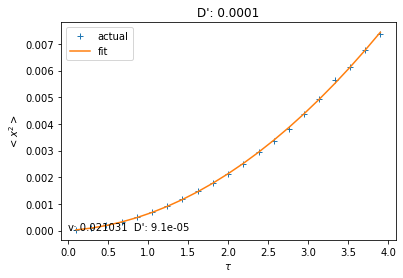

0.01 0.00013894954943731373


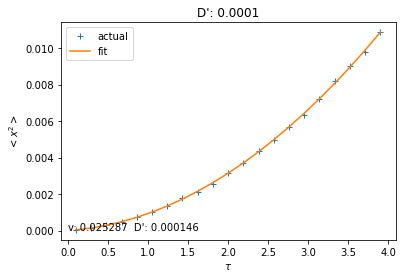

0.01 0.00019306977288832496


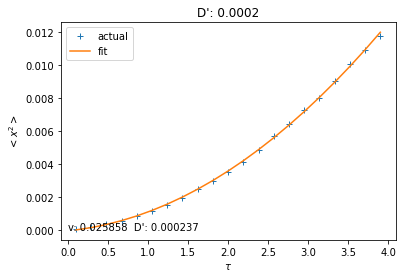

0.01 0.00026826957952797245


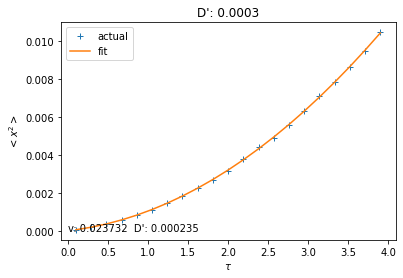

0.01 0.0003727593720314938


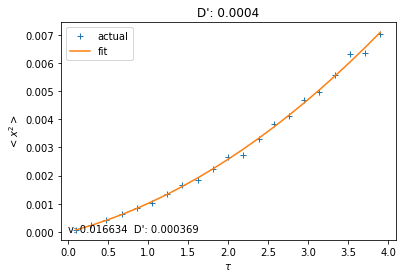

0.01 0.0005179474679231213


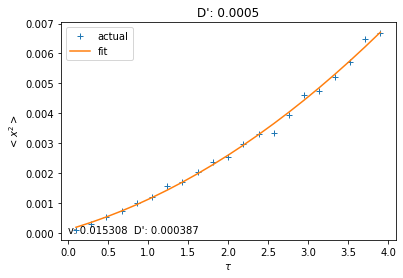

0.01 0.0007196856730011522


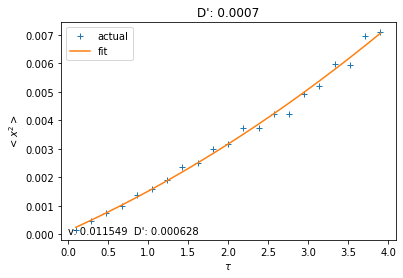

0.01 0.001


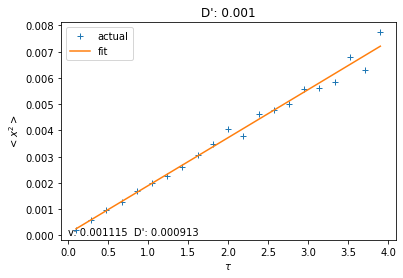

0.01 0.0013894954943731374


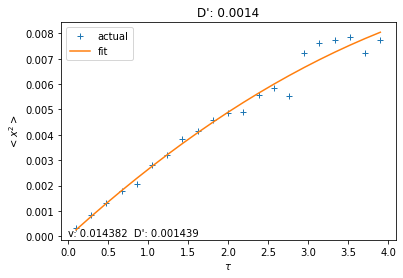

0.01 0.0019306977288832496


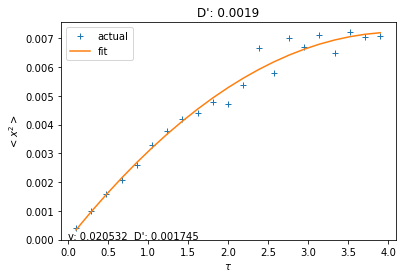

0.01 0.0026826957952797246


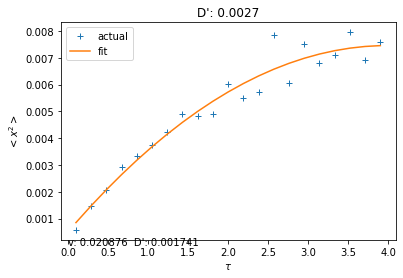

0.01 0.003727593720314938


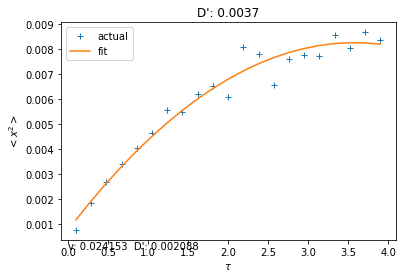

0.01 0.005179474679231213


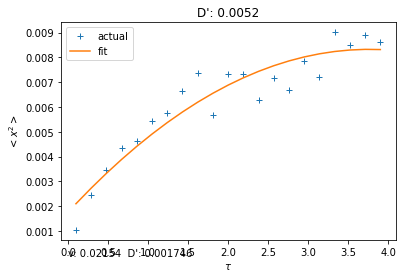

0.01 0.007196856730011514


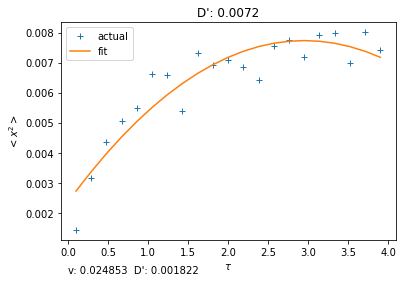

0.01 0.01


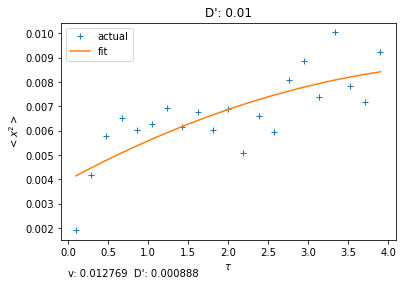

0.013894954943731374 0.0001


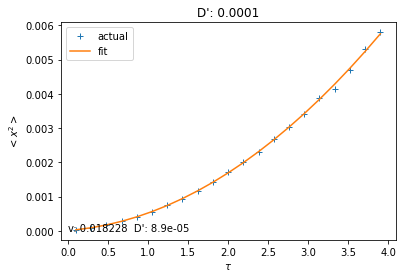

0.013894954943731374 0.00013894954943731373


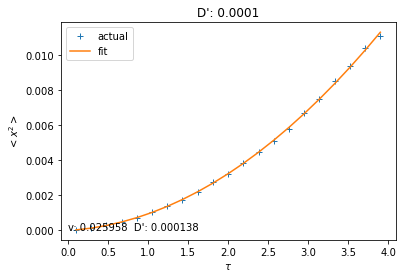

0.013894954943731374 0.00019306977288832496


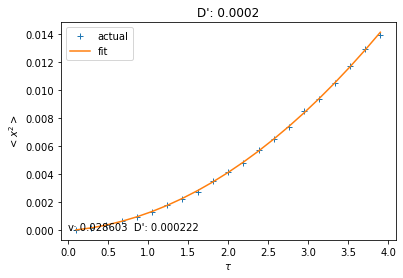

0.013894954943731374 0.00026826957952797245


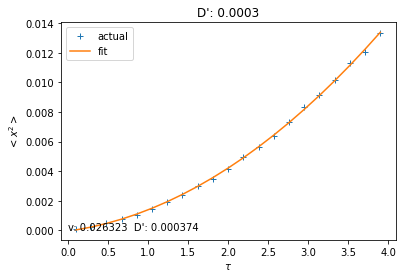

0.013894954943731374 0.0003727593720314938


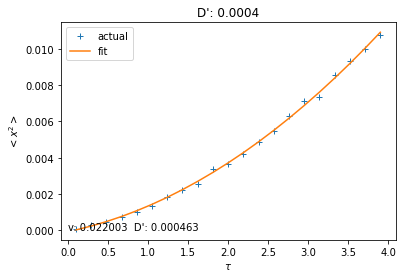

0.013894954943731374 0.0005179474679231213


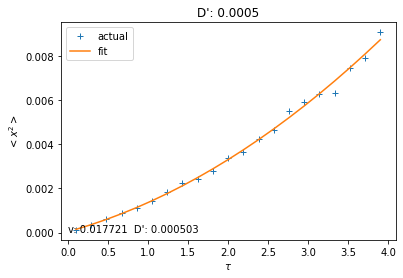

0.013894954943731374 0.0007196856730011522


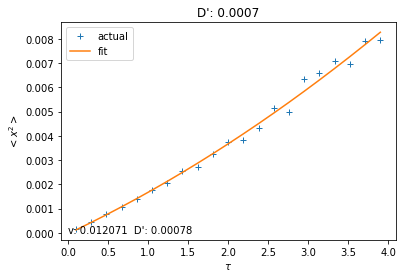

0.013894954943731374 0.001


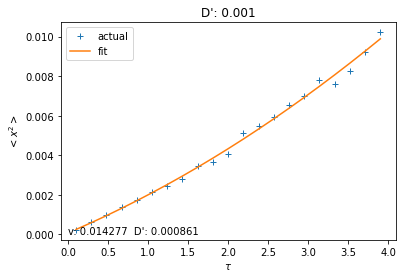

0.013894954943731374 0.0013894954943731374


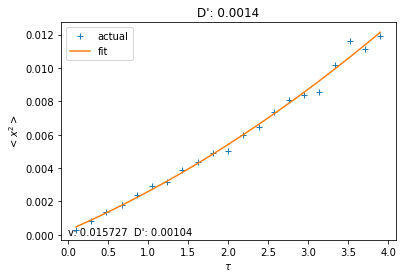

0.013894954943731374 0.0019306977288832496


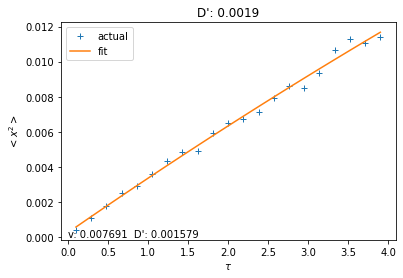

0.013894954943731374 0.0026826957952797246


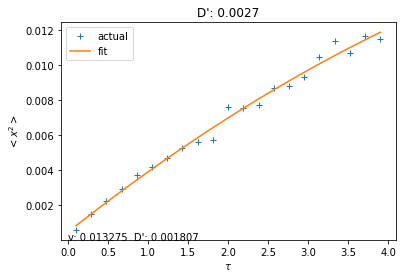

0.013894954943731374 0.003727593720314938


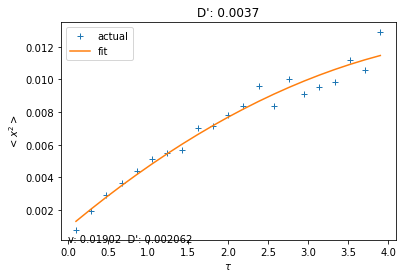

0.013894954943731374 0.005179474679231213


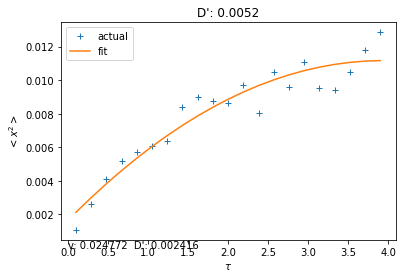

0.013894954943731374 0.007196856730011514


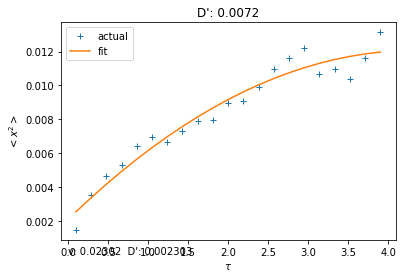

0.013894954943731374 0.01


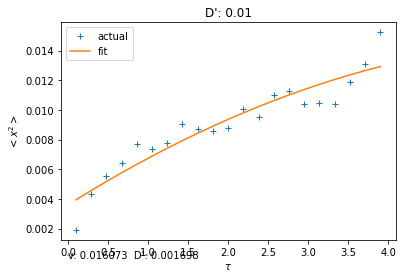

0.019306977288832496 0.0001


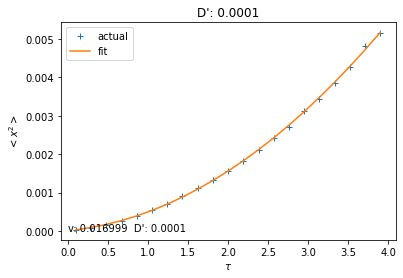

0.019306977288832496 0.00013894954943731373


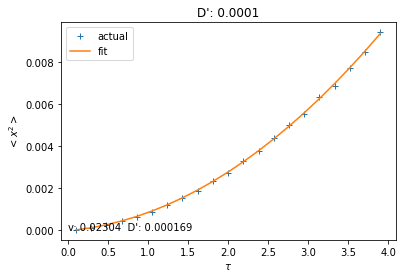

0.019306977288832496 0.00019306977288832496


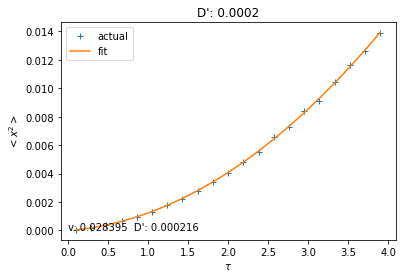

0.019306977288832496 0.00026826957952797245


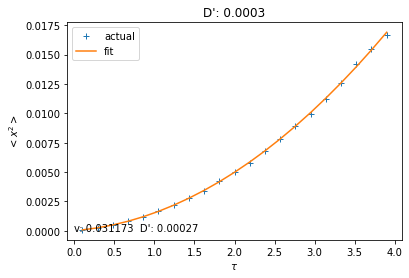

0.019306977288832496 0.0003727593720314938


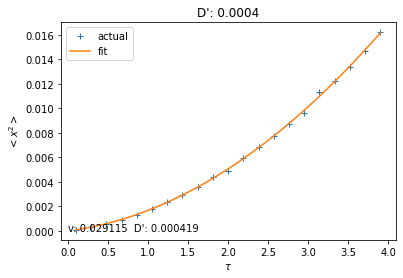

0.019306977288832496 0.0005179474679231213


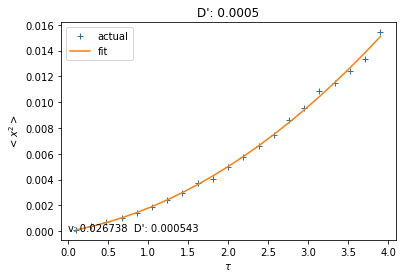

0.019306977288832496 0.0007196856730011522


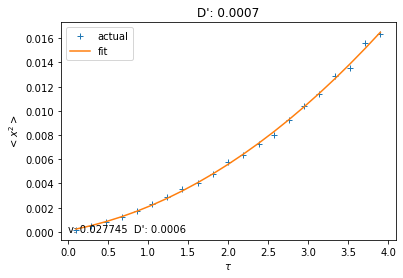

0.019306977288832496 0.001


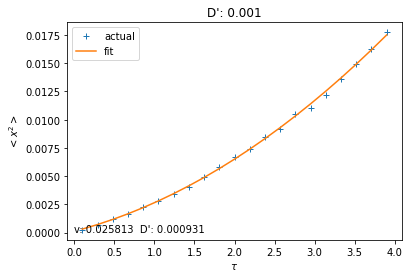

0.019306977288832496 0.0013894954943731374


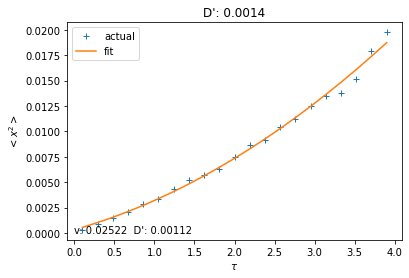

0.019306977288832496 0.0019306977288832496


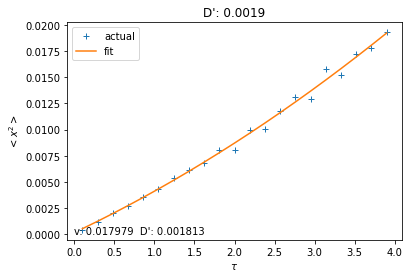

0.019306977288832496 0.0026826957952797246


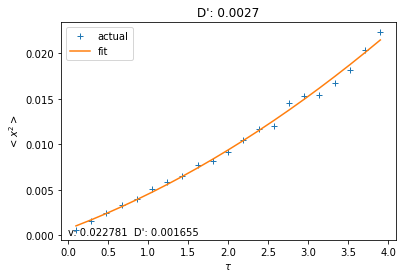

0.019306977288832496 0.003727593720314938


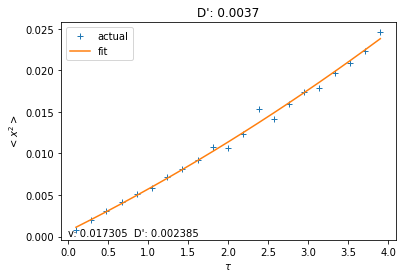

0.019306977288832496 0.005179474679231213


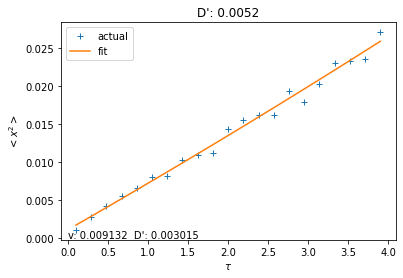

0.019306977288832496 0.007196856730011514


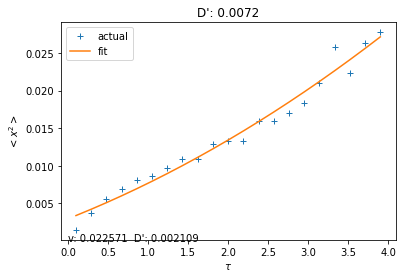

0.019306977288832496 0.01


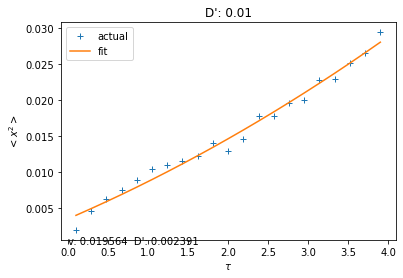

0.02682695795279726 0.0001


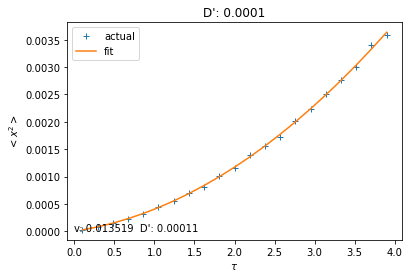

0.02682695795279726 0.00013894954943731373


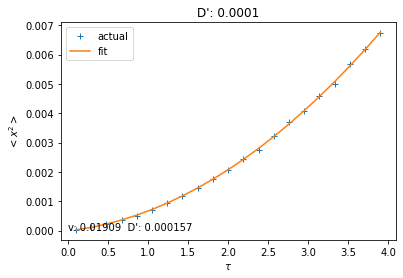

0.02682695795279726 0.00019306977288832496


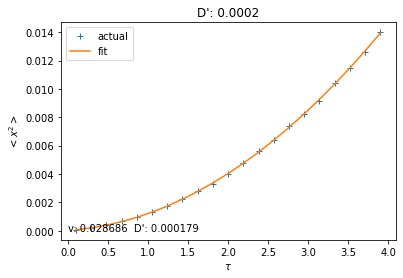

0.02682695795279726 0.00026826957952797245


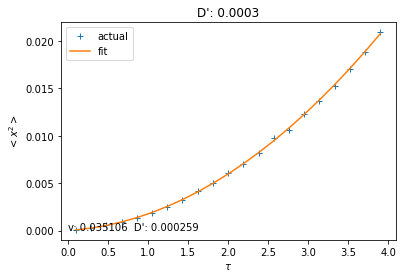

0.02682695795279726 0.0003727593720314938


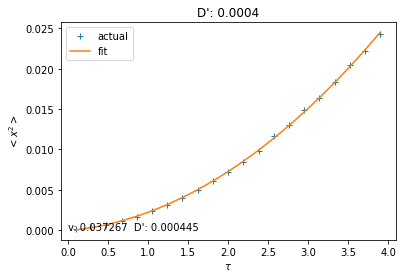

0.02682695795279726 0.0005179474679231213


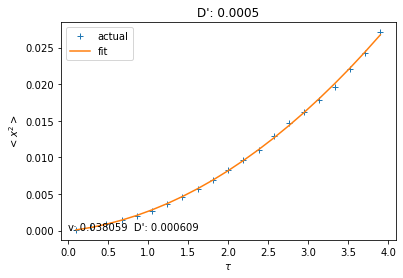

0.02682695795279726 0.0007196856730011522


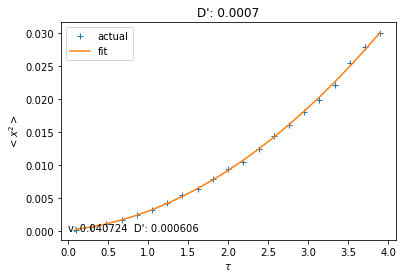

0.02682695795279726 0.001


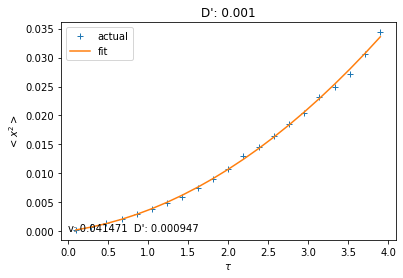

0.02682695795279726 0.0013894954943731374


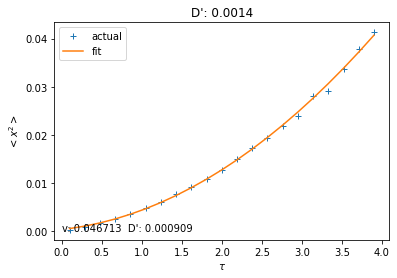

0.02682695795279726 0.0019306977288832496


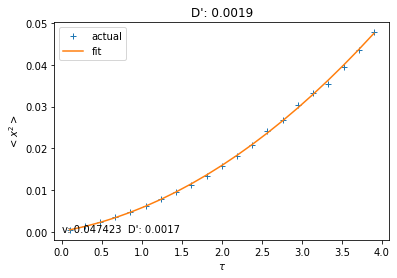

0.02682695795279726 0.0026826957952797246


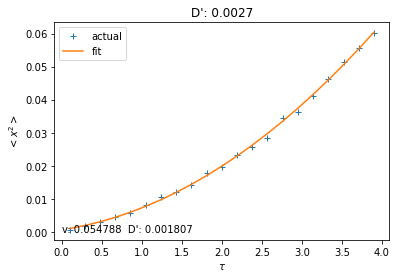

0.02682695795279726 0.003727593720314938


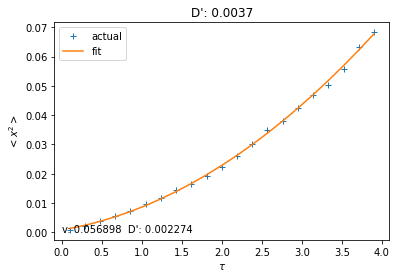

0.02682695795279726 0.005179474679231213


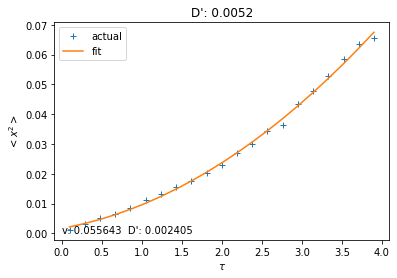

0.02682695795279726 0.007196856730011514


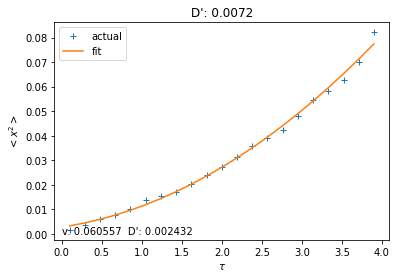

0.02682695795279726 0.01


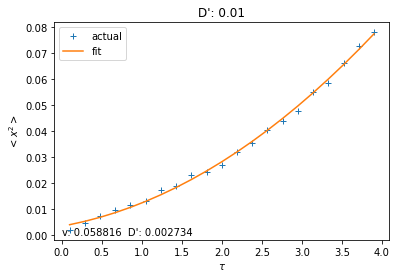

0.0372759372031494 0.0001


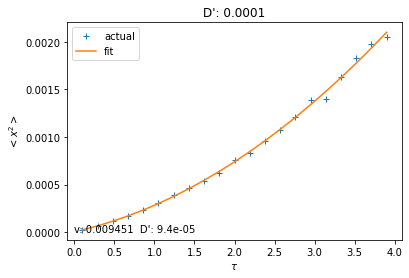

0.0372759372031494 0.00013894954943731373


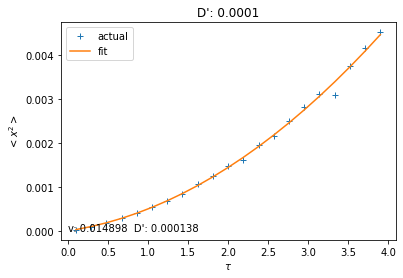

0.0372759372031494 0.00019306977288832496


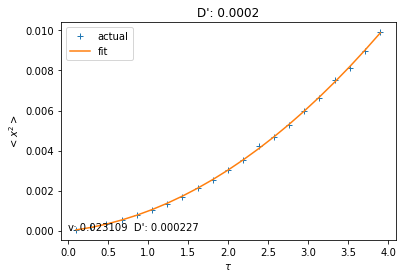

0.0372759372031494 0.00026826957952797245


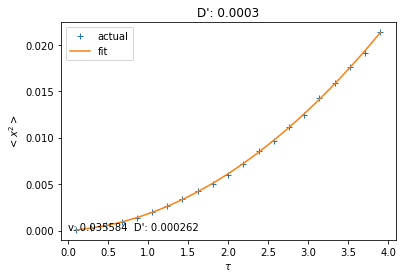

0.0372759372031494 0.0003727593720314938


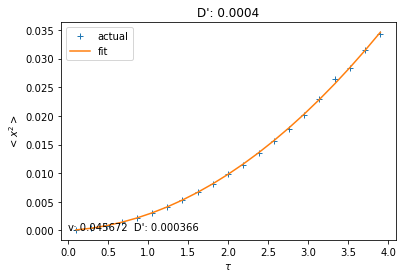

0.0372759372031494 0.0005179474679231213


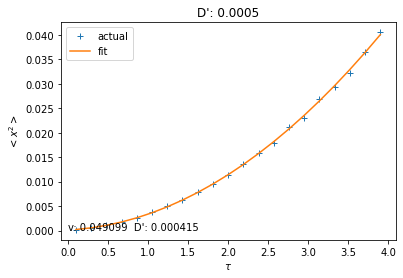

0.0372759372031494 0.0007196856730011522


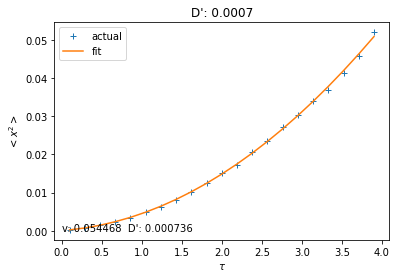

0.0372759372031494 0.001


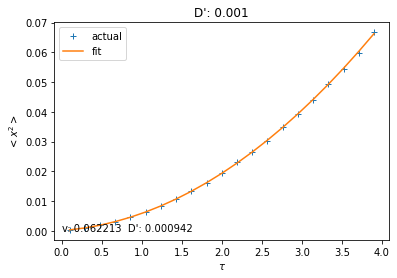

0.0372759372031494 0.0013894954943731374


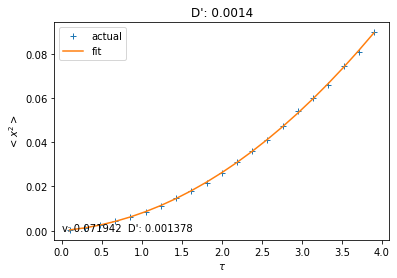

0.0372759372031494 0.0019306977288832496


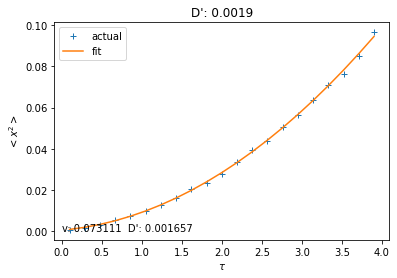

0.0372759372031494 0.0026826957952797246


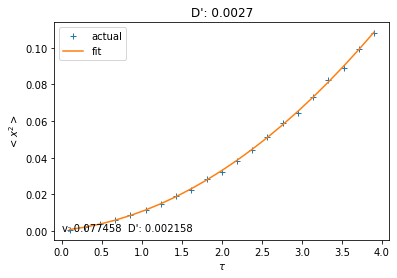

0.0372759372031494 0.003727593720314938


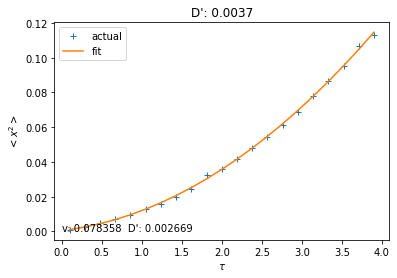

0.0372759372031494 0.005179474679231213


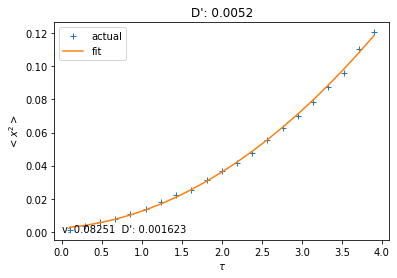

0.0372759372031494 0.007196856730011514


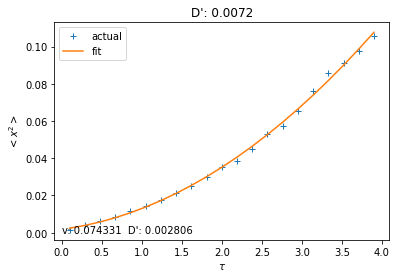

0.0372759372031494 0.01


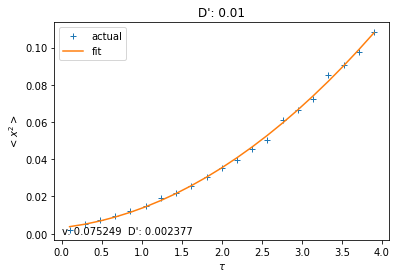

0.0517947467923121 0.0001


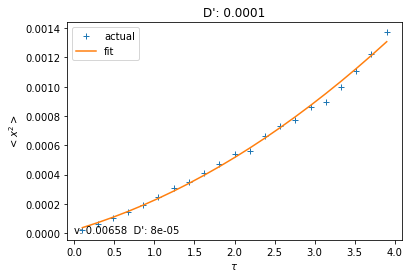

0.0517947467923121 0.00013894954943731373


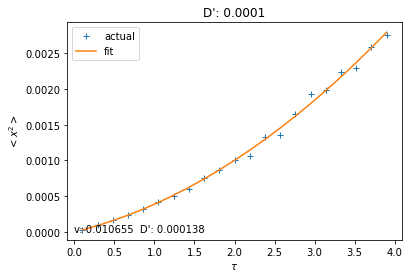

0.0517947467923121 0.00019306977288832496


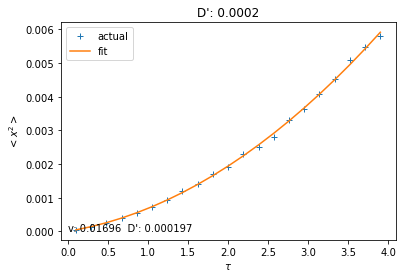

0.0517947467923121 0.00026826957952797245


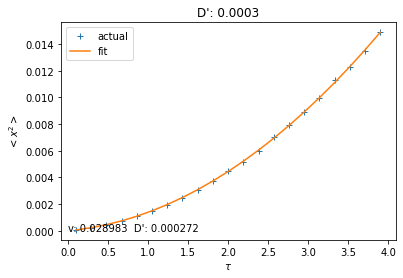

0.0517947467923121 0.0003727593720314938


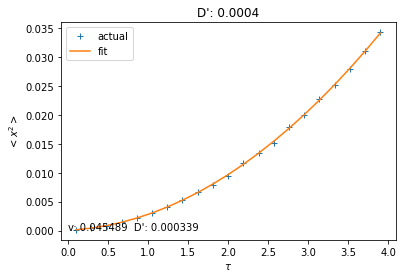

0.0517947467923121 0.0005179474679231213


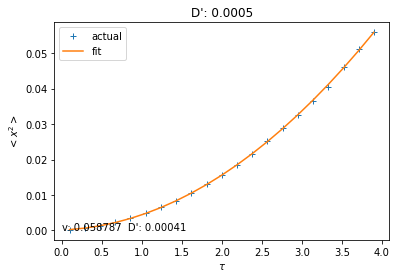

0.0517947467923121 0.0007196856730011522


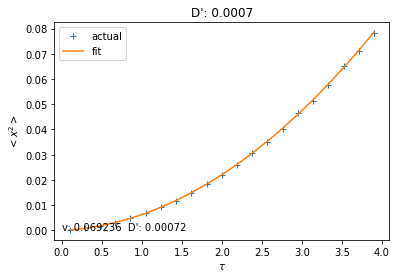

0.0517947467923121 0.001


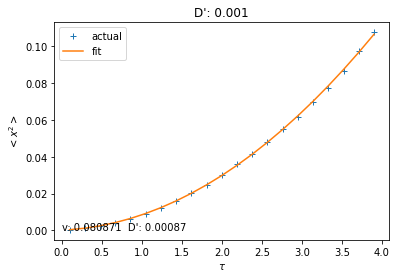

0.0517947467923121 0.0013894954943731374


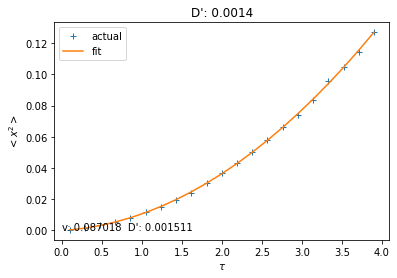

0.0517947467923121 0.0019306977288832496


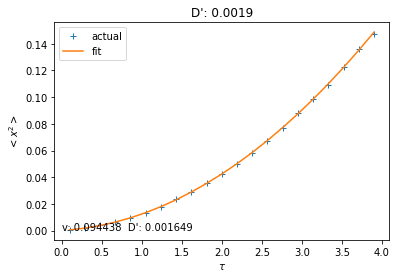

0.0517947467923121 0.0026826957952797246


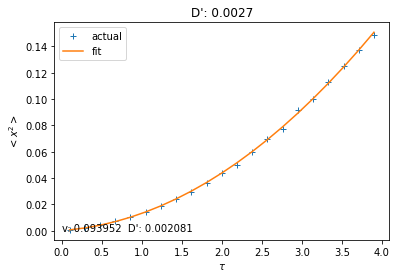

0.0517947467923121 0.003727593720314938


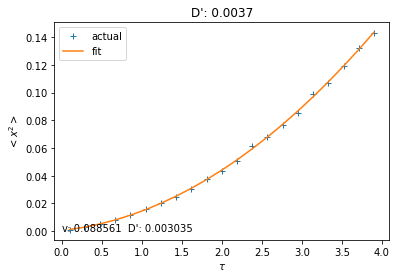

0.0517947467923121 0.005179474679231213


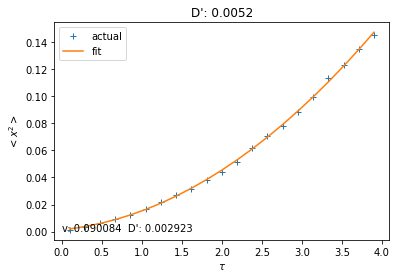

0.0517947467923121 0.007196856730011514


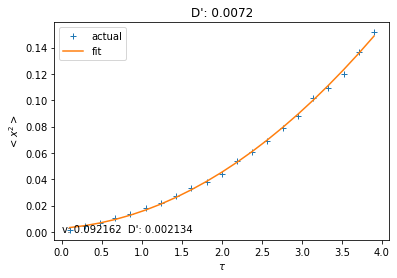

0.0517947467923121 0.01


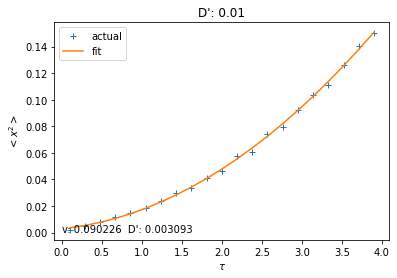

0.07196856730011521 0.0001


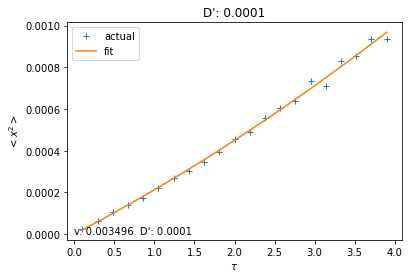

0.07196856730011521 0.00013894954943731373


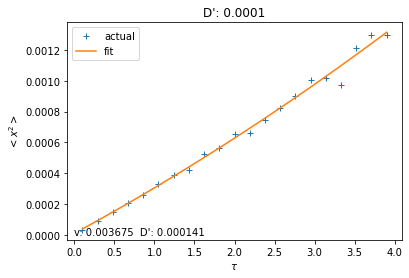

0.07196856730011521 0.00019306977288832496


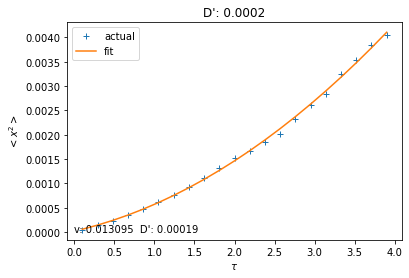

0.07196856730011521 0.00026826957952797245


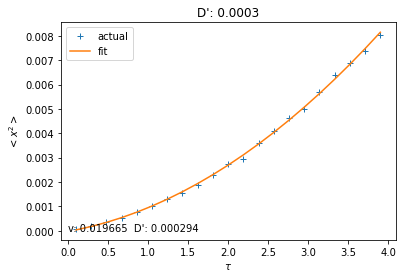

0.07196856730011521 0.0003727593720314938


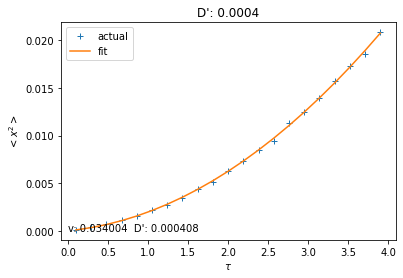

0.07196856730011521 0.0005179474679231213


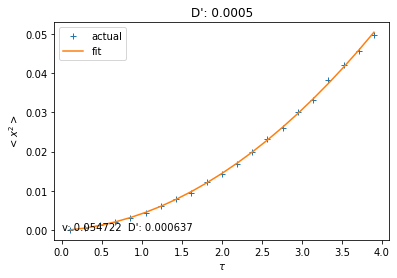

0.07196856730011521 0.0007196856730011522


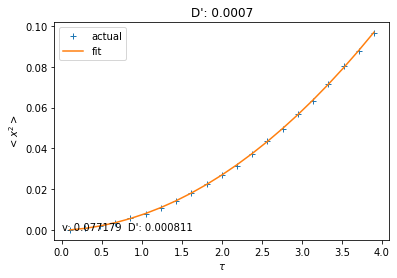

0.07196856730011521 0.001


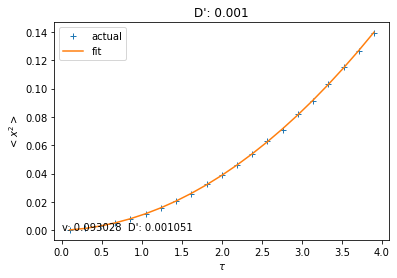

0.07196856730011521 0.0013894954943731374


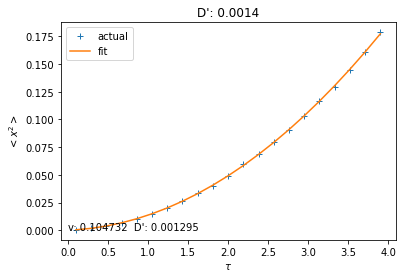

0.07196856730011521 0.0019306977288832496


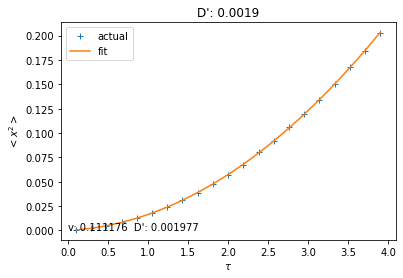

0.07196856730011521 0.0026826957952797246


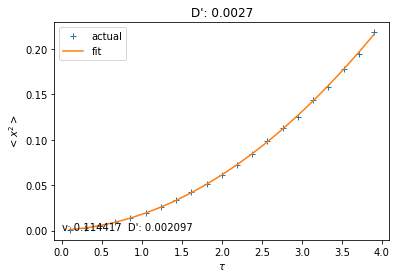

0.07196856730011521 0.003727593720314938


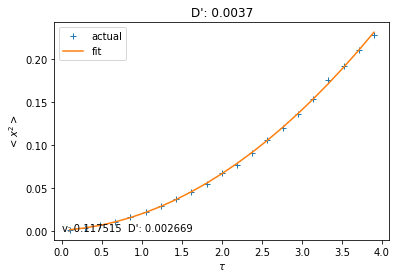

0.07196856730011521 0.005179474679231213


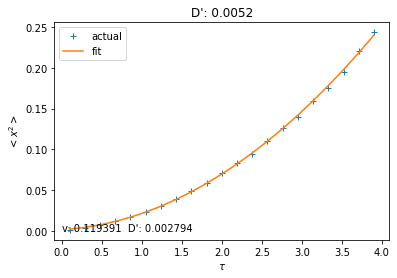

0.07196856730011521 0.007196856730011514


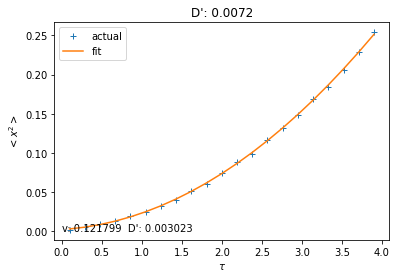

0.07196856730011521 0.01


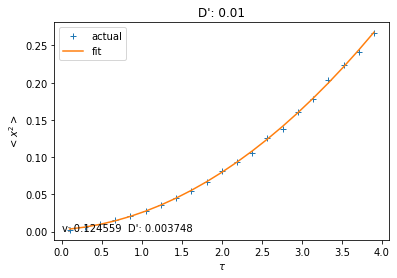

0.1 0.0001


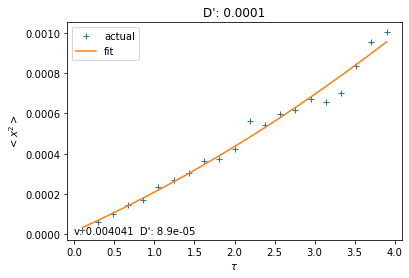

0.1 0.00013894954943731373


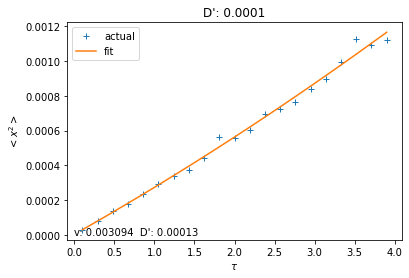

0.1 0.00019306977288832496


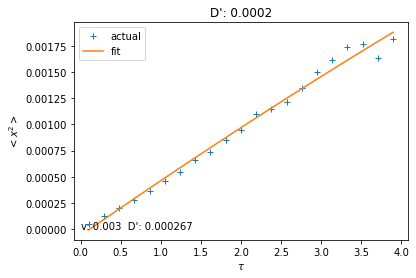

0.1 0.00026826957952797245


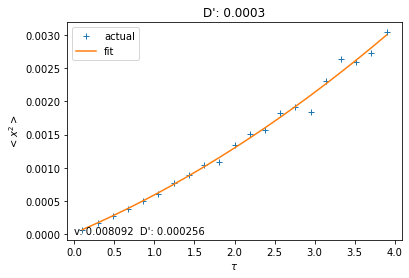

0.1 0.0003727593720314938


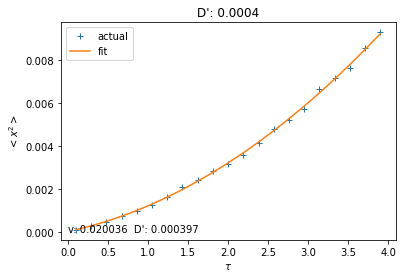

0.1 0.0005179474679231213


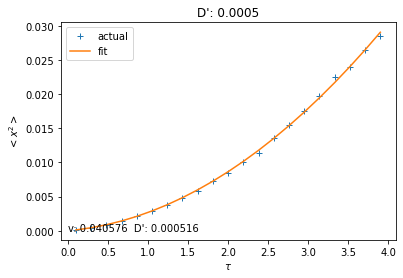

0.1 0.0007196856730011522


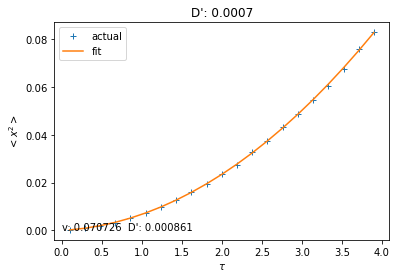

0.1 0.001


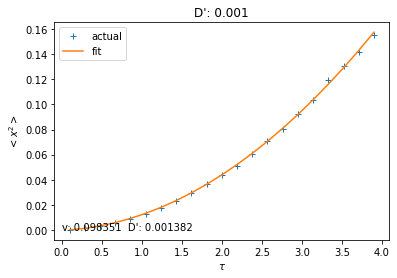

0.1 0.0013894954943731374


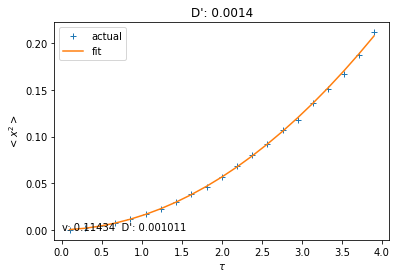

0.1 0.0019306977288832496


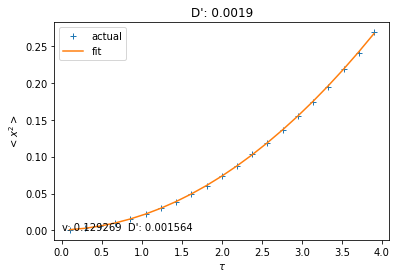

0.1 0.0026826957952797246


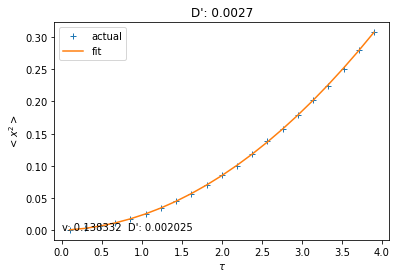

0.1 0.003727593720314938


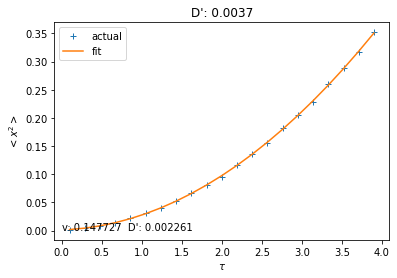

0.1 0.005179474679231213


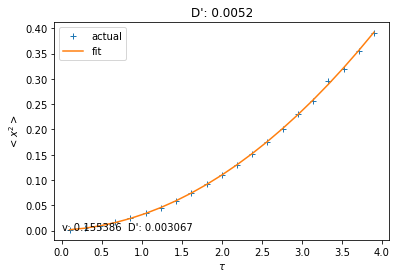

0.1 0.007196856730011514


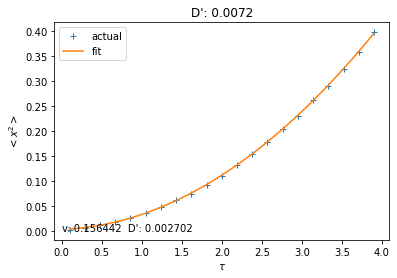

0.1 0.01


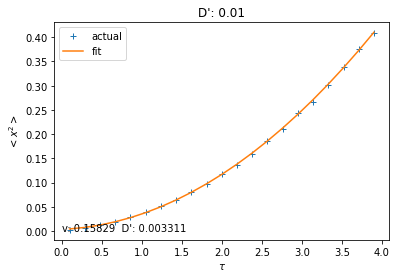

0.13894954943731375 0.0001


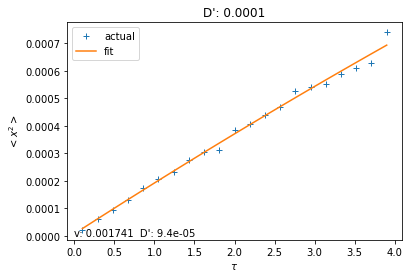

0.13894954943731375 0.00013894954943731373


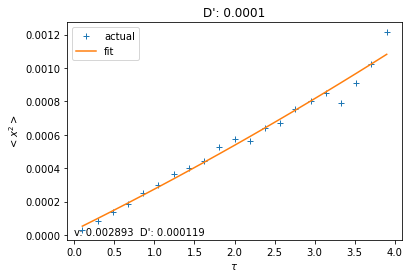

0.13894954943731375 0.00019306977288832496


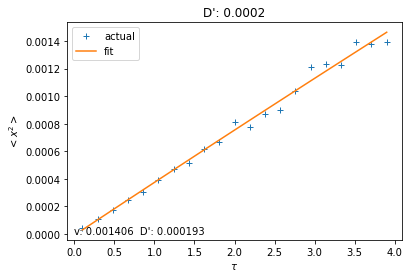

0.13894954943731375 0.00026826957952797245


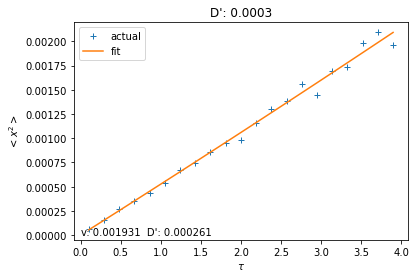

0.13894954943731375 0.0003727593720314938


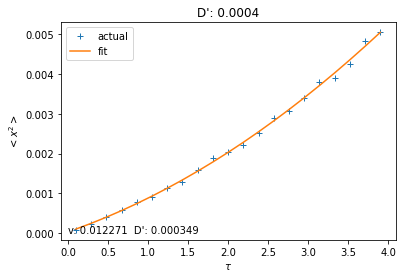

0.13894954943731375 0.0005179474679231213


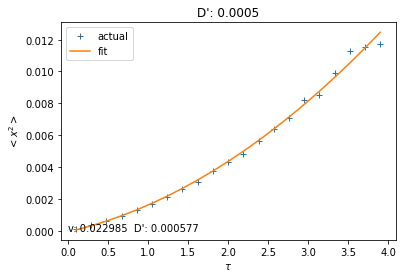

0.13894954943731375 0.0007196856730011522


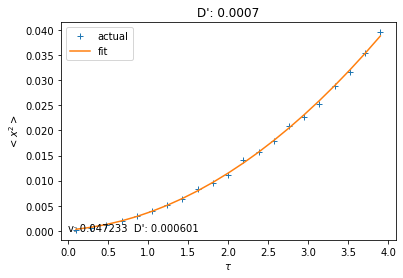

0.13894954943731375 0.001


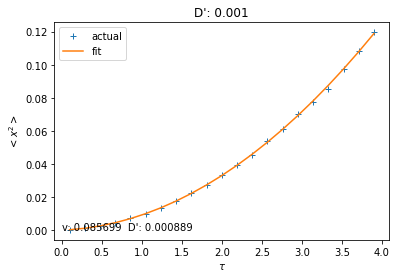

0.13894954943731375 0.0013894954943731374


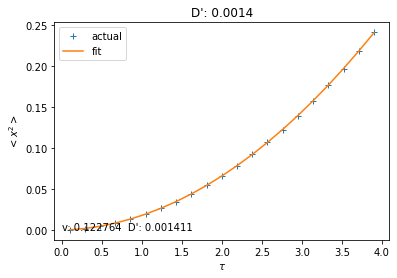

0.13894954943731375 0.0019306977288832496


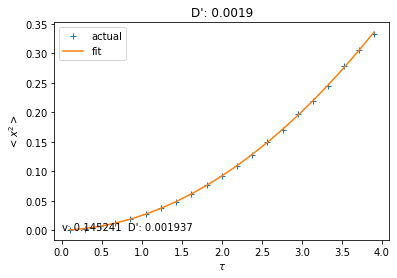

0.13894954943731375 0.0026826957952797246


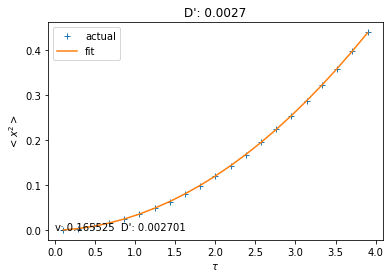

0.13894954943731375 0.003727593720314938


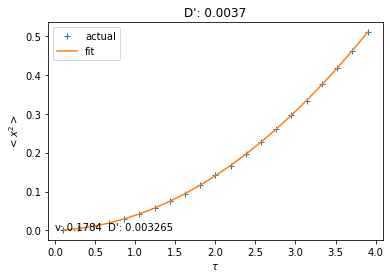

0.13894954943731375 0.005179474679231213


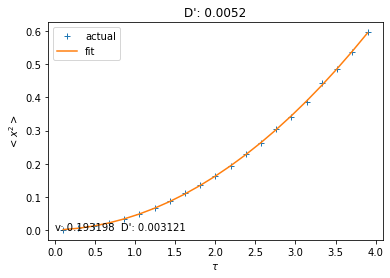

0.13894954943731375 0.007196856730011514


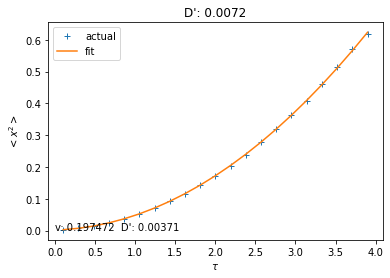

0.13894954943731375 0.01


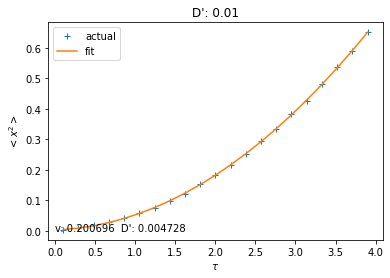

0.19306977288832497 0.0001


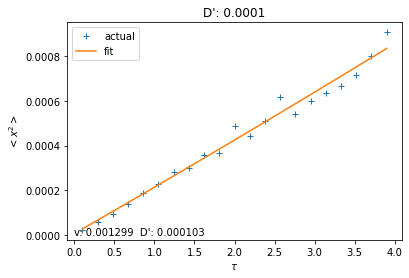

0.19306977288832497 0.00013894954943731373


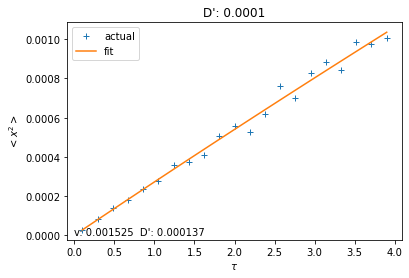

0.19306977288832497 0.00019306977288832496


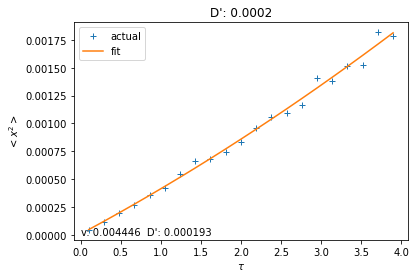

0.19306977288832497 0.00026826957952797245


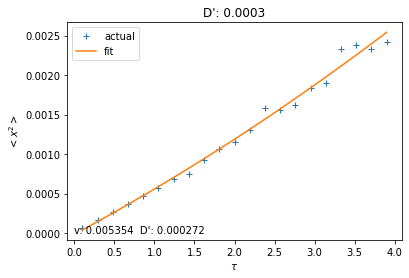

0.19306977288832497 0.0003727593720314938


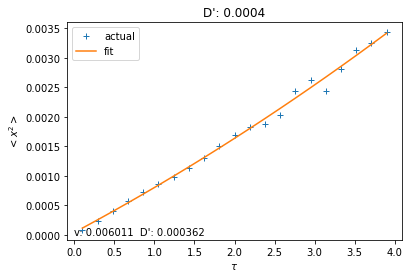

0.19306977288832497 0.0005179474679231213


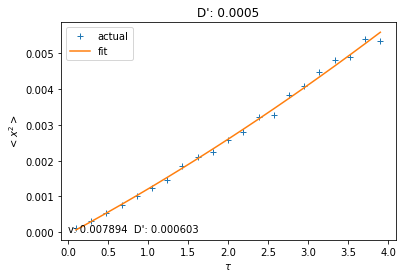

0.19306977288832497 0.0007196856730011522


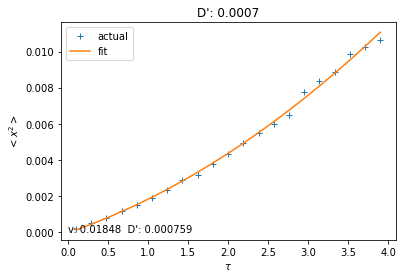

0.19306977288832497 0.001


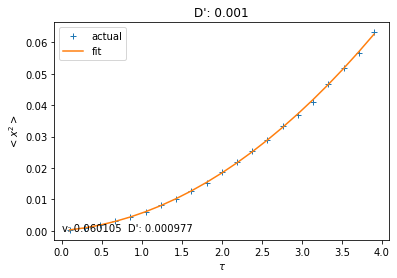

0.19306977288832497 0.0013894954943731374


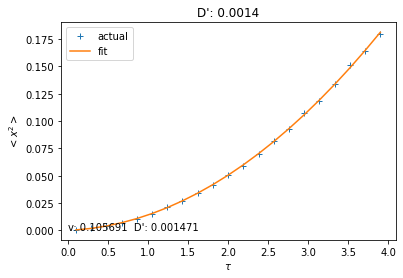

0.19306977288832497 0.0019306977288832496


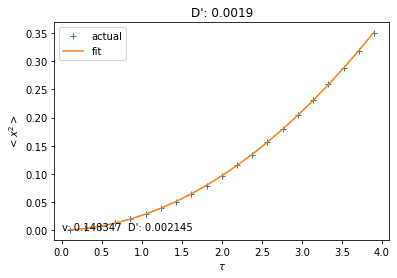

0.19306977288832497 0.0026826957952797246


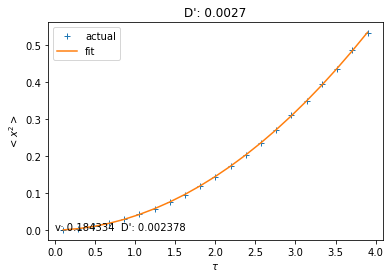

0.19306977288832497 0.003727593720314938


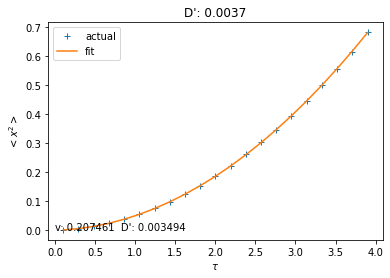

0.19306977288832497 0.005179474679231213


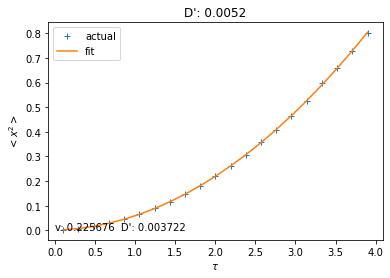

0.19306977288832497 0.007196856730011514


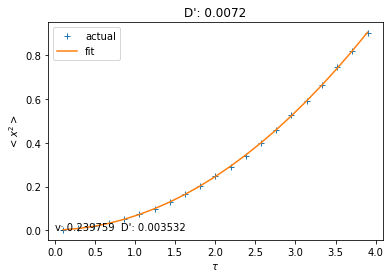

0.19306977288832497 0.01


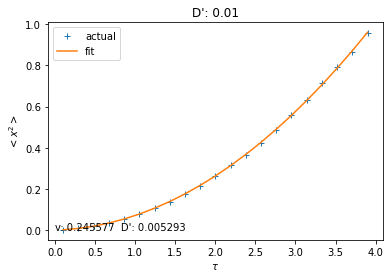

0.2682695795279725 0.0001


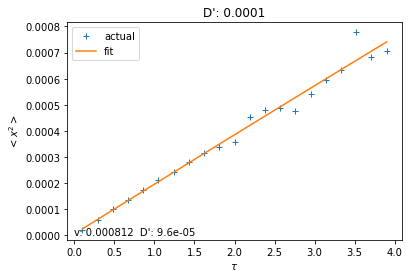

0.2682695795279725 0.00013894954943731373


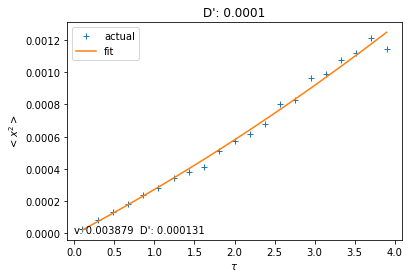

0.2682695795279725 0.00019306977288832496


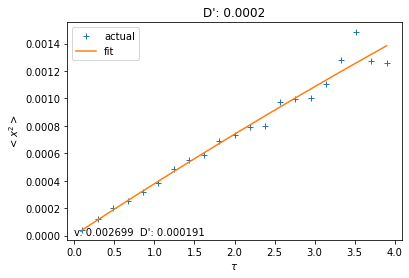

0.2682695795279725 0.00026826957952797245


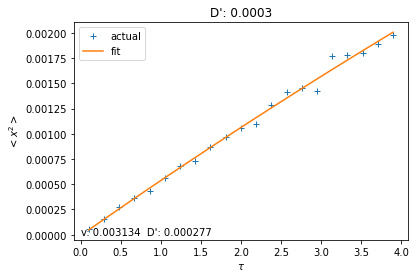

0.2682695795279725 0.0003727593720314938


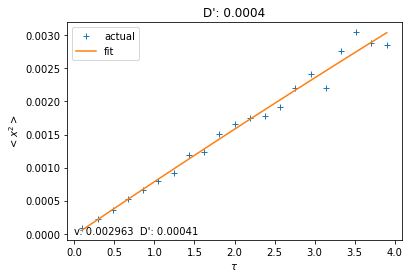

0.2682695795279725 0.0005179474679231213


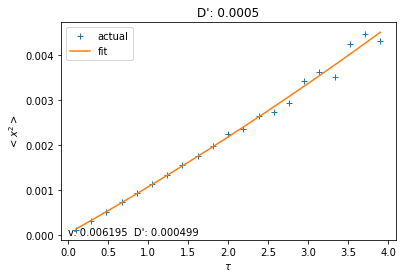

0.2682695795279725 0.0007196856730011522


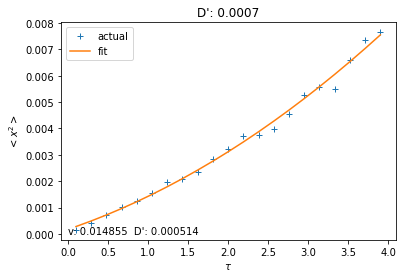

0.2682695795279725 0.001


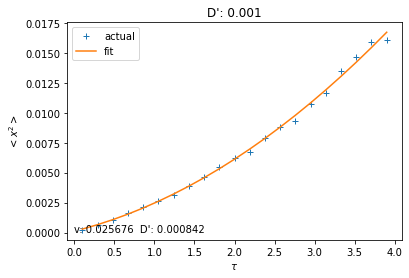

0.2682695795279725 0.0013894954943731374


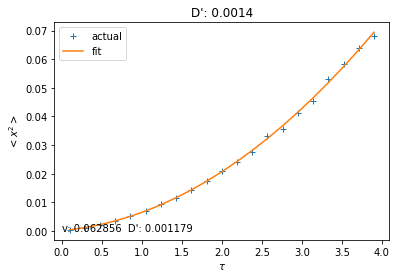

0.2682695795279725 0.0019306977288832496


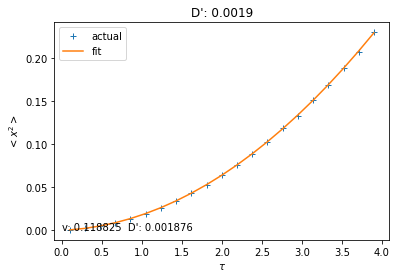

0.2682695795279725 0.0026826957952797246


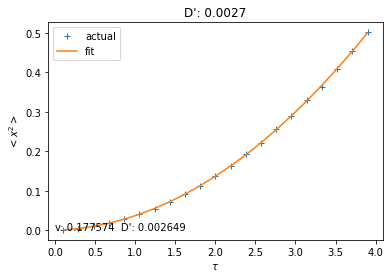

0.2682695795279725 0.003727593720314938


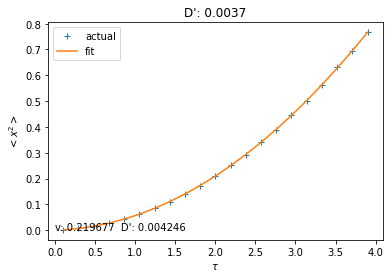

0.2682695795279725 0.005179474679231213


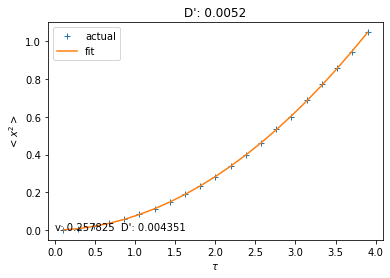

0.2682695795279725 0.007196856730011514


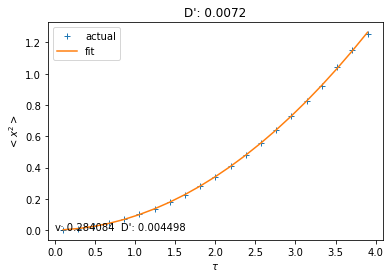

0.2682695795279725 0.01


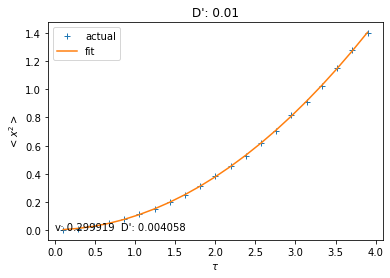

0.372759372031494 0.0001


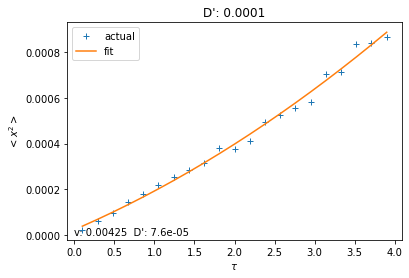

0.372759372031494 0.00013894954943731373


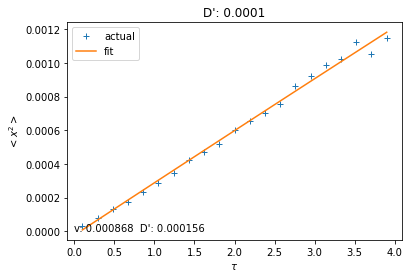

0.372759372031494 0.00019306977288832496


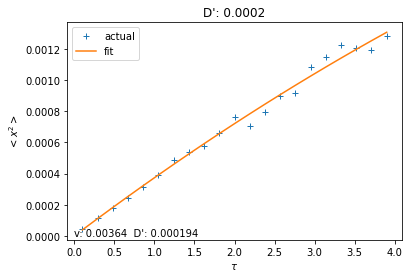

0.372759372031494 0.00026826957952797245


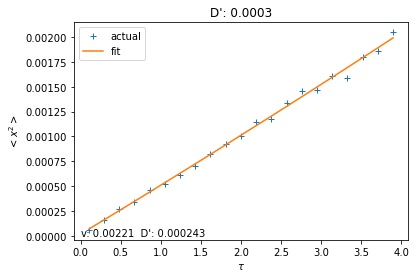

0.372759372031494 0.0003727593720314938


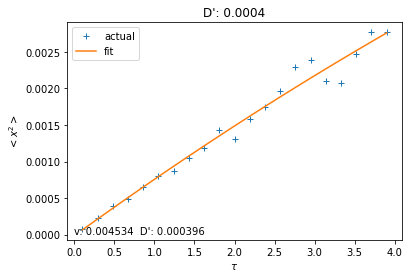

0.372759372031494 0.0005179474679231213


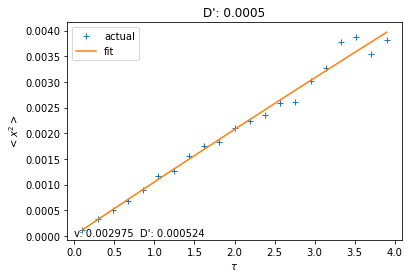

0.372759372031494 0.0007196856730011522


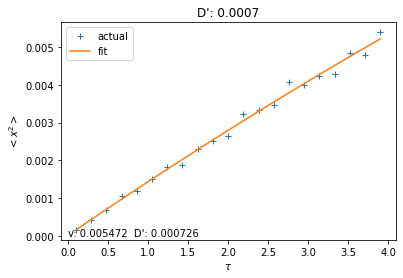

0.372759372031494 0.001


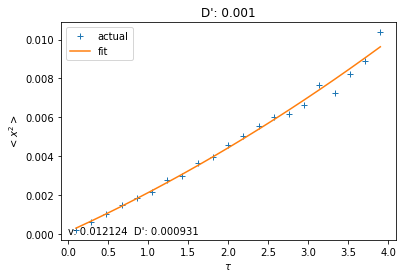

0.372759372031494 0.0013894954943731374


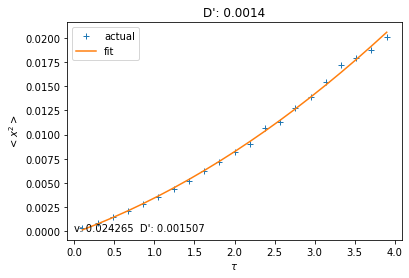

0.372759372031494 0.0019306977288832496


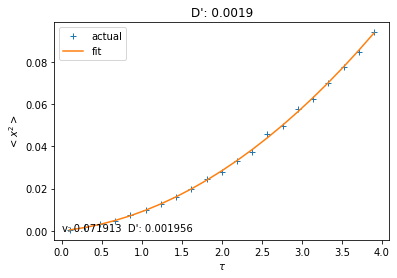

0.372759372031494 0.0026826957952797246


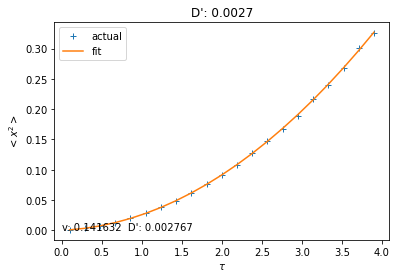

0.372759372031494 0.003727593720314938


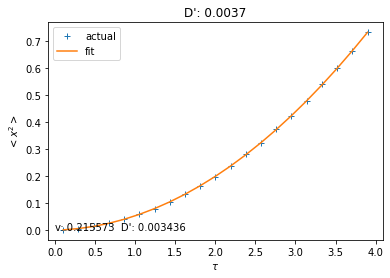

0.372759372031494 0.005179474679231213


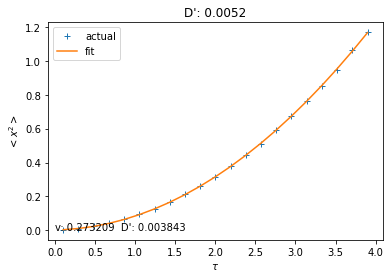

0.372759372031494 0.007196856730011514


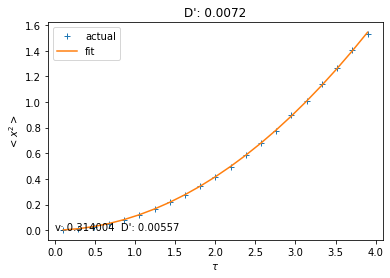

0.372759372031494 0.01


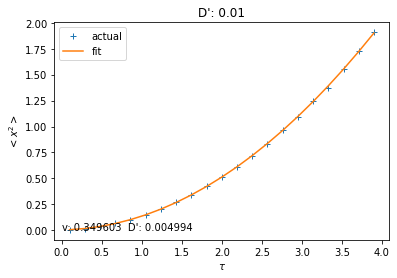

0.517947467923121 0.0001


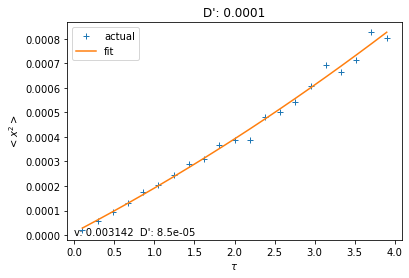

0.517947467923121 0.00013894954943731373


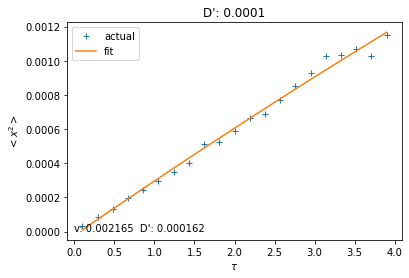

0.517947467923121 0.00019306977288832496


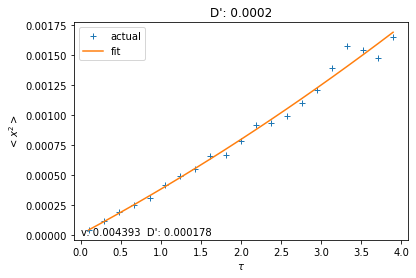

0.517947467923121 0.00026826957952797245


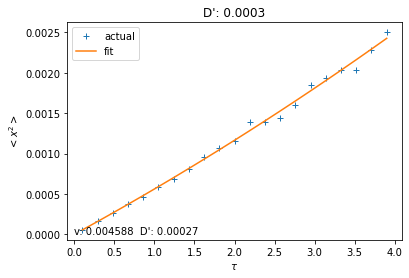

0.517947467923121 0.0003727593720314938


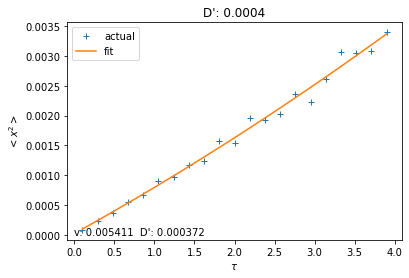

0.517947467923121 0.0005179474679231213


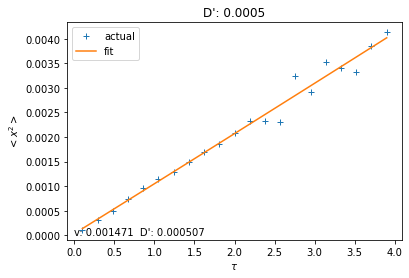

0.517947467923121 0.0007196856730011522


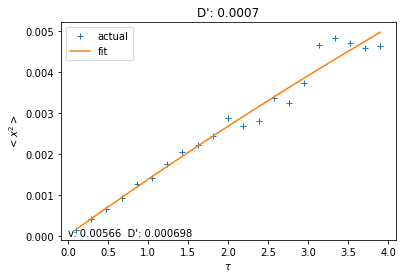

0.517947467923121 0.001


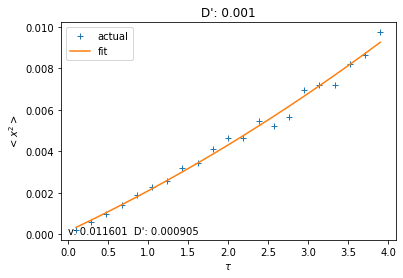

0.517947467923121 0.0013894954943731374


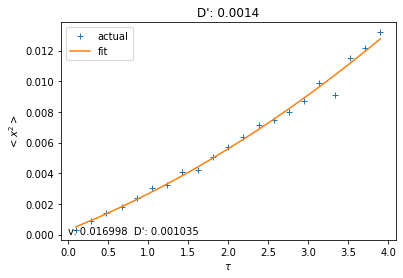

0.517947467923121 0.0019306977288832496


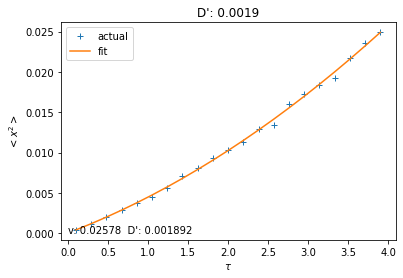

0.517947467923121 0.0026826957952797246


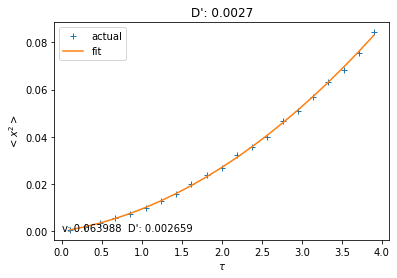

0.517947467923121 0.003727593720314938


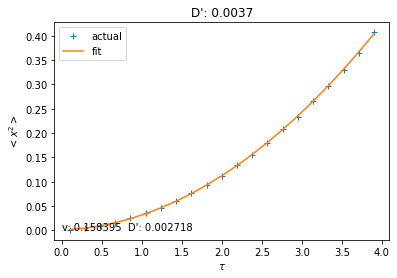

0.517947467923121 0.005179474679231213


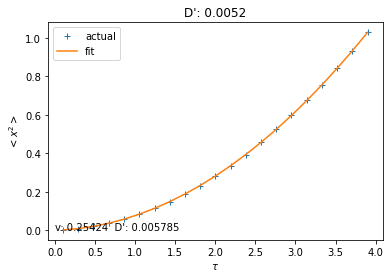

0.517947467923121 0.007196856730011514


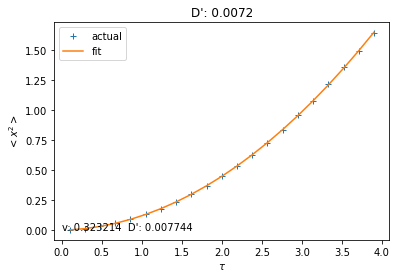

0.517947467923121 0.01


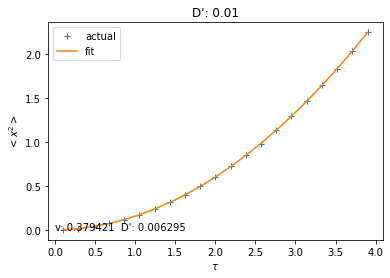

0.7196856730011517 0.0001


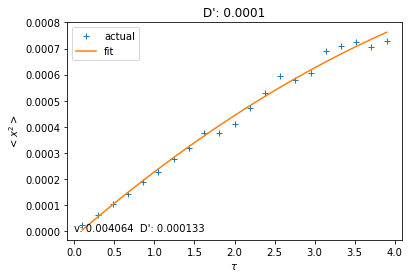

0.7196856730011517 0.00013894954943731373


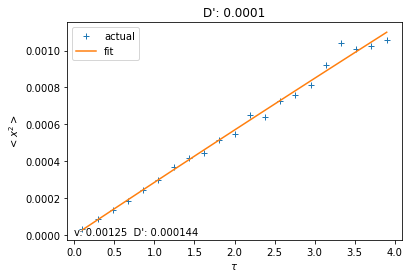

0.7196856730011517 0.00019306977288832496


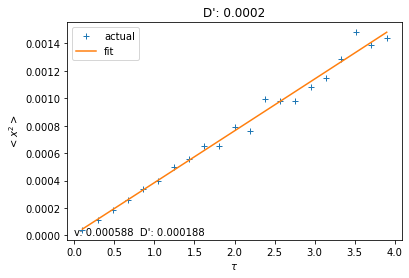

0.7196856730011517 0.00026826957952797245


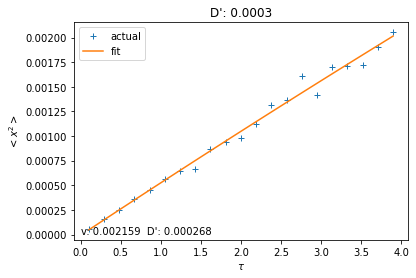

0.7196856730011517 0.0003727593720314938


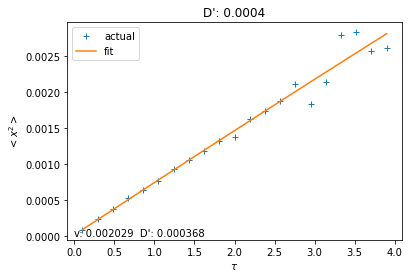

0.7196856730011517 0.0005179474679231213


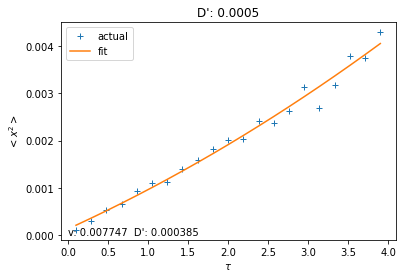

0.7196856730011517 0.0007196856730011522


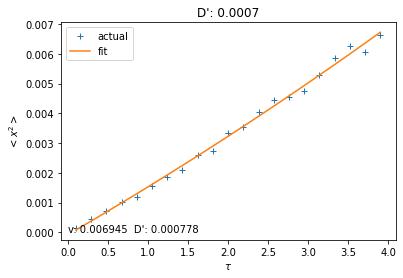

0.7196856730011517 0.001


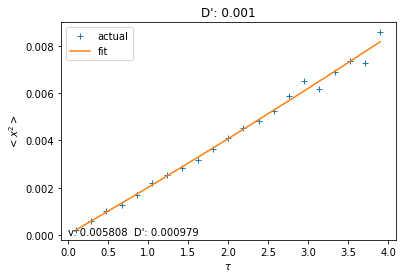

0.7196856730011517 0.0013894954943731374


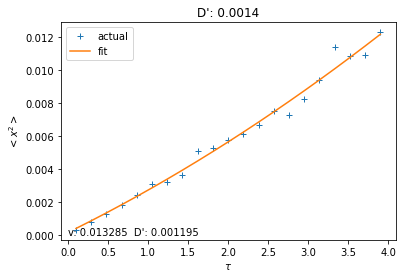

0.7196856730011517 0.0019306977288832496


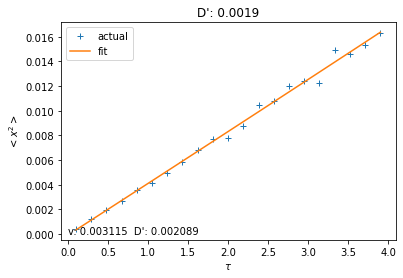

0.7196856730011517 0.0026826957952797246


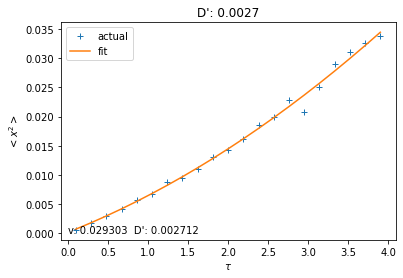

0.7196856730011517 0.003727593720314938


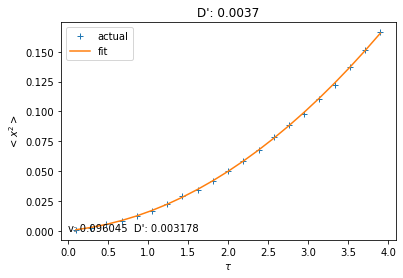

0.7196856730011517 0.005179474679231213


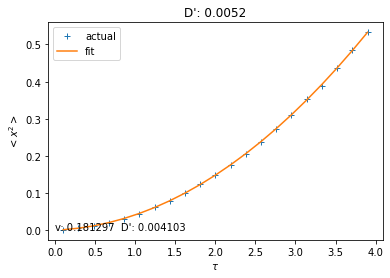

0.7196856730011517 0.007196856730011514


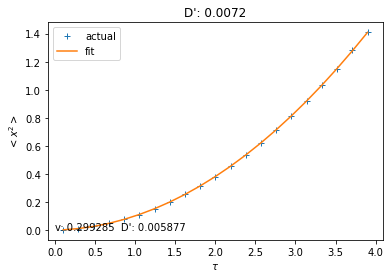

0.7196856730011517 0.01


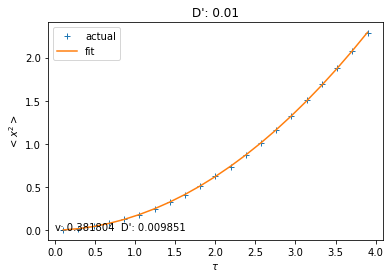

1.0 0.0001


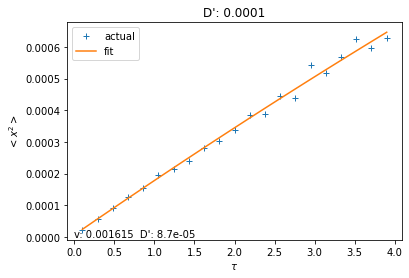

1.0 0.00013894954943731373


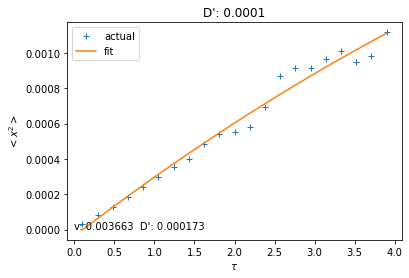

1.0 0.00019306977288832496


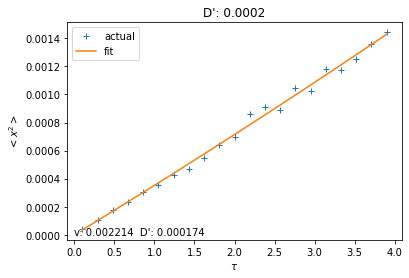

1.0 0.00026826957952797245


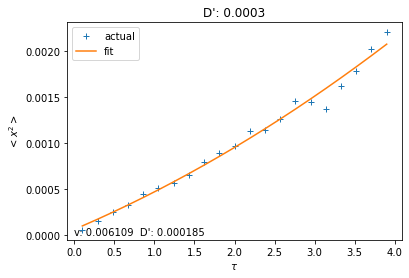

1.0 0.0003727593720314938


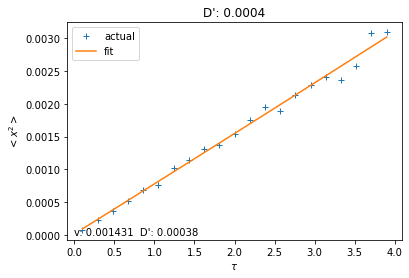

1.0 0.0005179474679231213


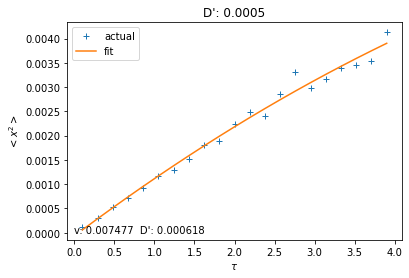

1.0 0.0007196856730011522


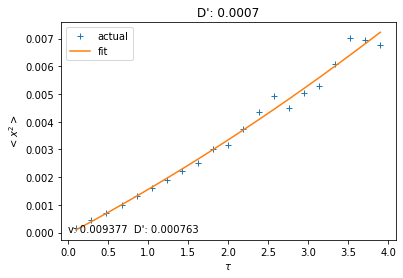

1.0 0.001


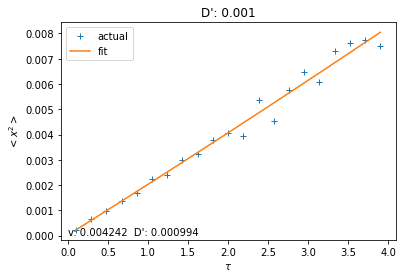

1.0 0.0013894954943731374


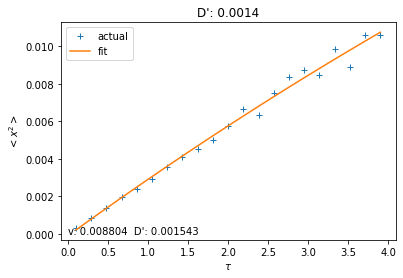

1.0 0.0019306977288832496


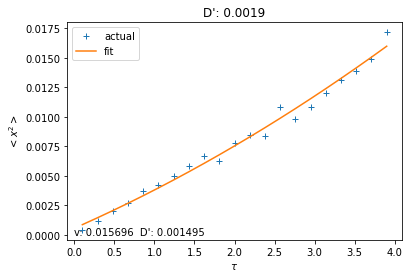

1.0 0.0026826957952797246


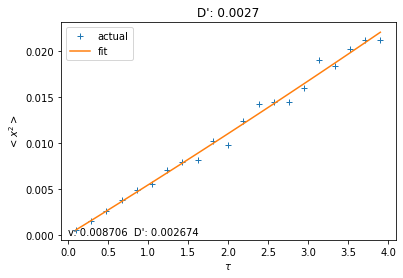

1.0 0.003727593720314938


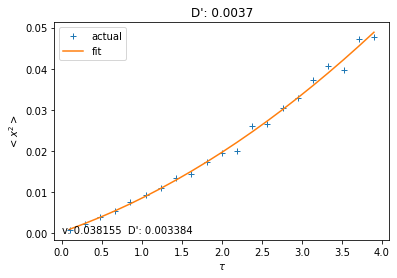

1.0 0.005179474679231213


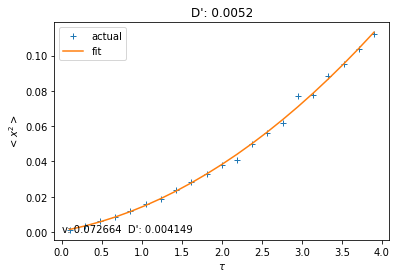

1.0 0.007196856730011514


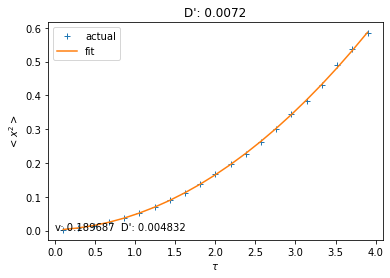

1.0 0.01


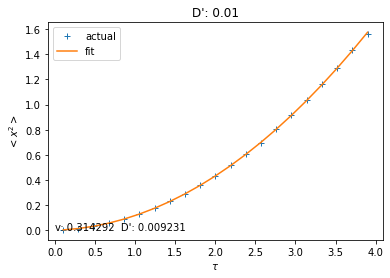

In [7]:
def quadratic(x,a,b,c):
    return a*x**2 + b*x +c 

effsq0 = []
vsq0 = []
burnsq0 = []
for i in range(nu_n):
    effsq1 = []
    vsq1 = []
    burnsq1 = []
    for j in range(D_n): # diffusion coefficients
        print(nus[i],Ds[j])
        tmax = len(sol_0Db[i][j][0][0])
        taumax = tmax/5
        taus = array(range(10,int(taumax),int((taumax-10)/20)))
        
        burn_aves = []
        for k in range(run_n):
            burn_aves.append(mean(array(sol_0Db[i][j][k][1]),axis=0))
        x2_tau = []
        for n in taus:
            x2 = [] 
            for l in range(run_n):
                xps = array(sol_0Db[i][j][l][0])
                x2.extend(diff(xps[::(n+1)])**2)
                
            x2_tau.append(mean(x2))
        x = taus*10*dt
        y = x2_tau
        popt,pcov = curve_fit(quadratic,x,y,p0=[1,1,1])
        
    
        title("D': "+str(round(Ds[j],4)))
        #title(r"$\nu'$: "+str(round(nus[i],3)))
        plot(x,y,"+",label ="actual")
        plot(x,quadratic(x,*popt),label = "fit")
        text(0,0,"v: "+str(round(sqrt(abs(popt[0])),6))+ "  D': "+str(round(popt[1]/2,6)))
        ylabel(r"$<x^2>$")
        xlabel(r"$\tau$")
        legend()
        show()
        eff = 1/Ds[j]*popt[0]/mean(burn_aves)
        effsq1.append(eff)
        vsq1.append(sqrt(abs(popt[0])))
        burnsq1.append(mean(burn_aves))
    effsq0.append(effsq1)
    vsq0.append(vsq1)
    burnsq0.append(burnsq1)
effsq0 = array(effsq0)
vsq0 = array(vsq0)
burnsq0 = array(burnsq0)

    

### efficiency with histogram fit

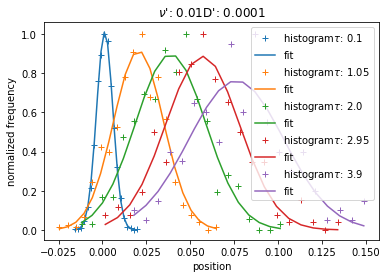

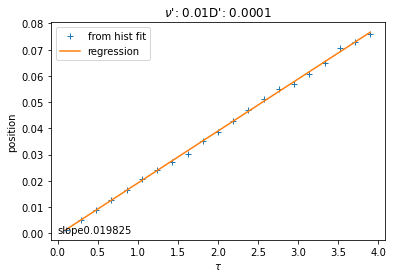

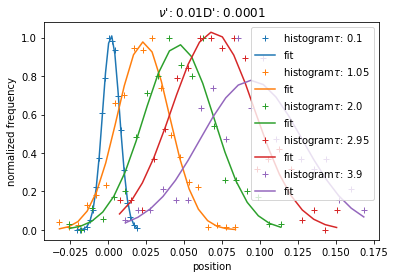

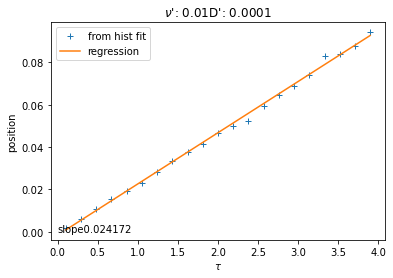

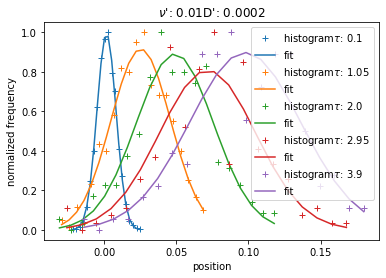

...

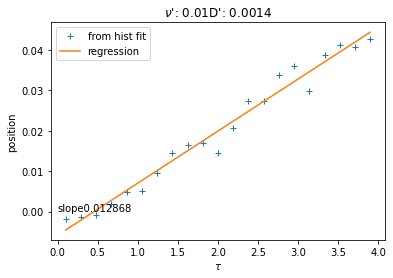

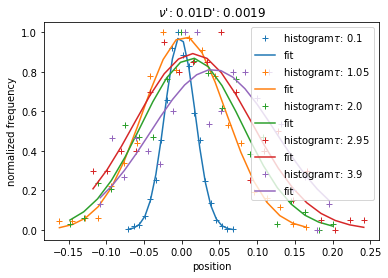

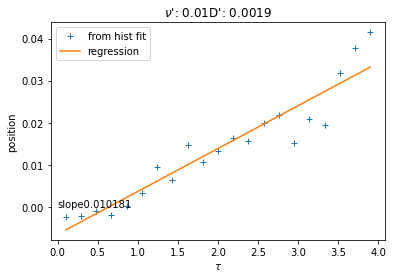

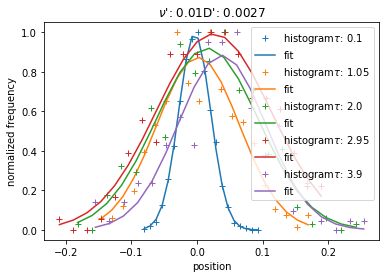

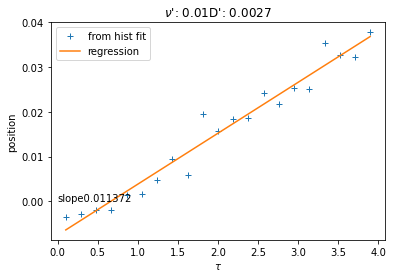

<ipython-input-8-913dec42f73d>:28: RuntimeWarning: overflow encountered in exp
  return a*numpy.exp(-(x-ave)**2/(2*sigma))


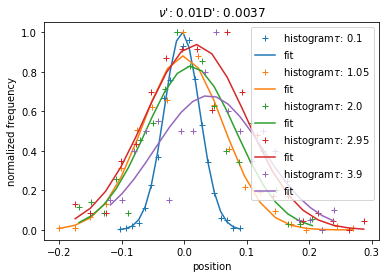

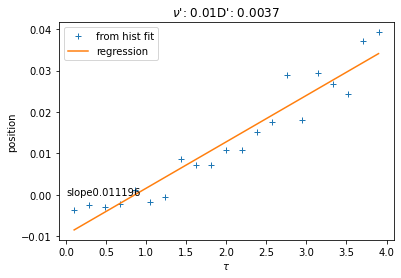

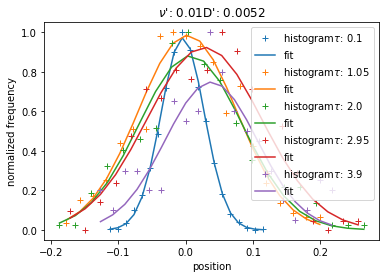

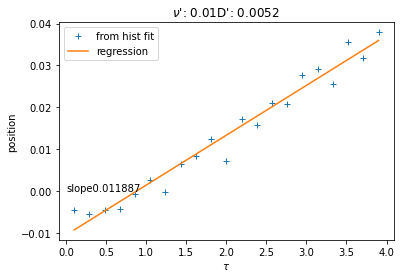

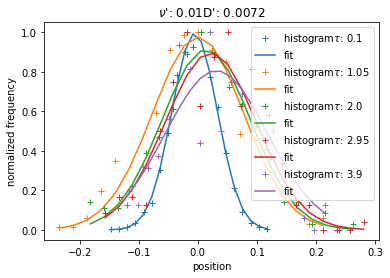

...

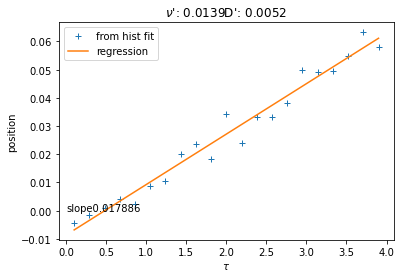

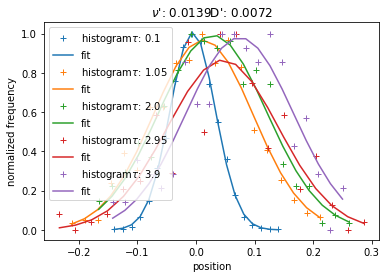

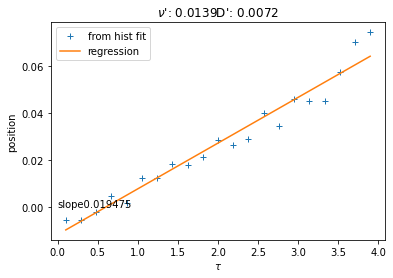

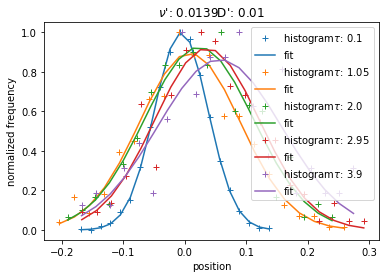

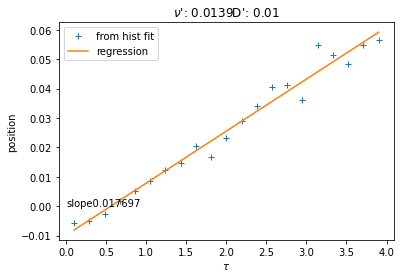

<ipython-input-8-913dec42f73d>:28: RuntimeWarning: overflow encountered in exp
  return a*numpy.exp(-(x-ave)**2/(2*sigma))


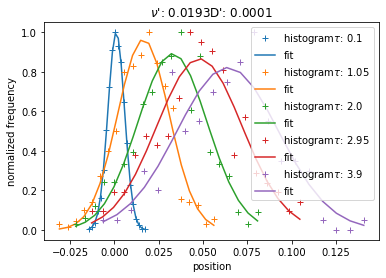

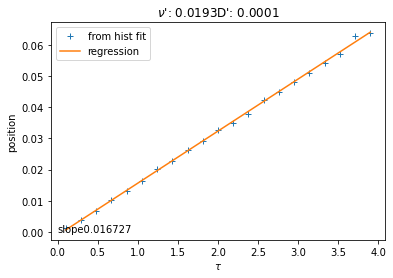

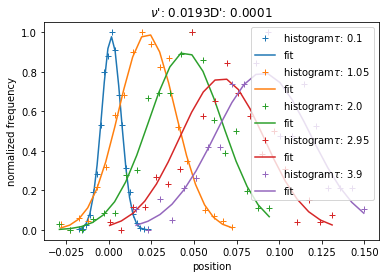

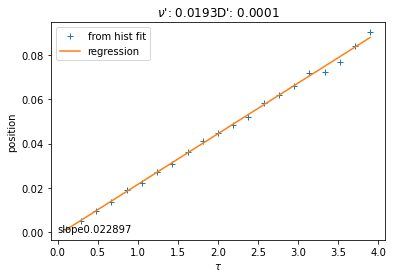

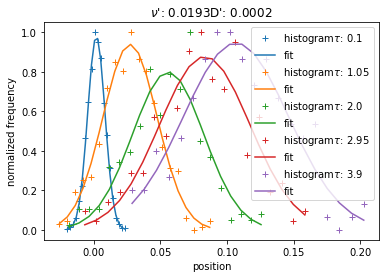

...

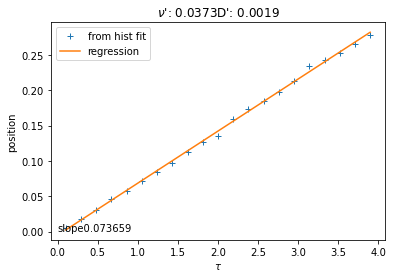

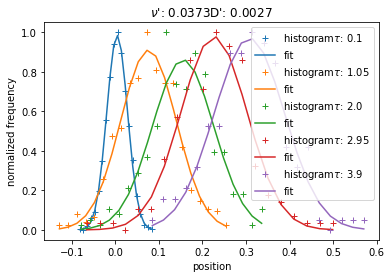

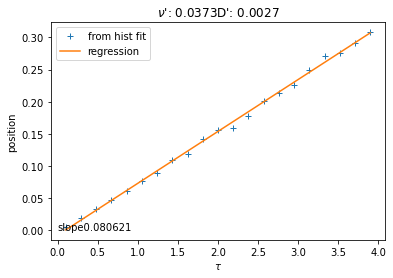

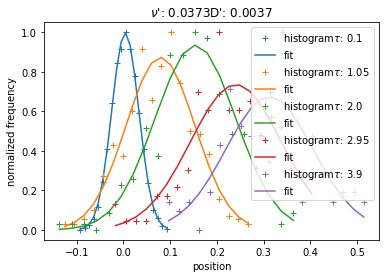

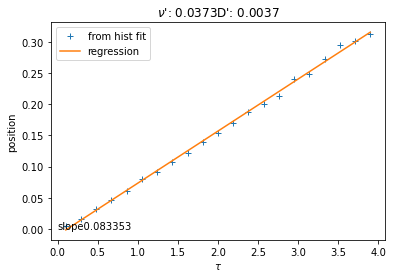

<ipython-input-8-913dec42f73d>:28: RuntimeWarning: overflow encountered in exp
  return a*numpy.exp(-(x-ave)**2/(2*sigma))


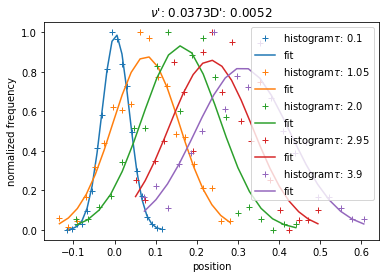

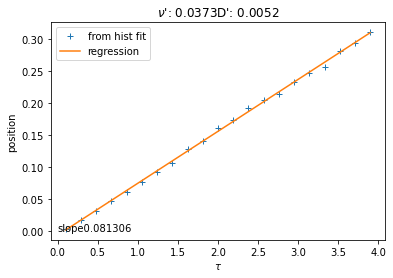

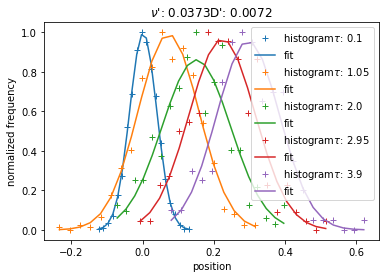

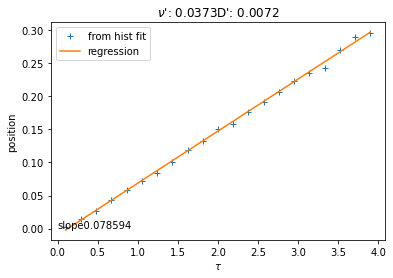

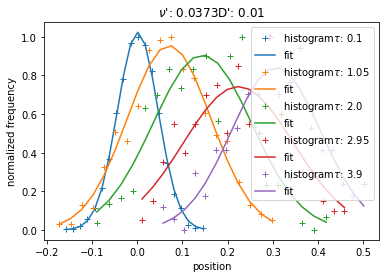

...

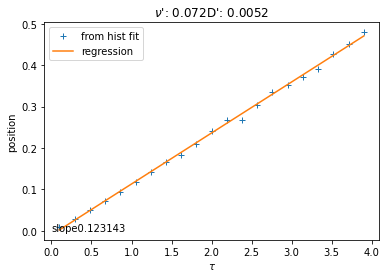

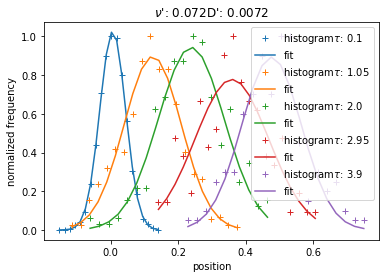

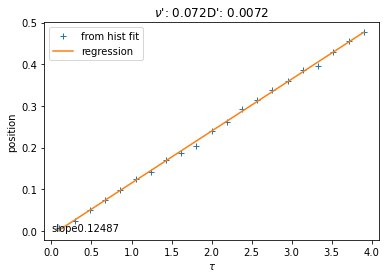

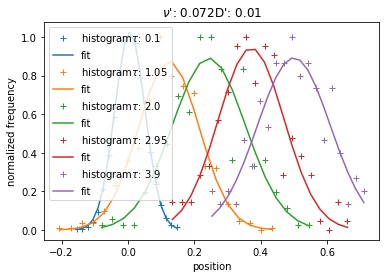

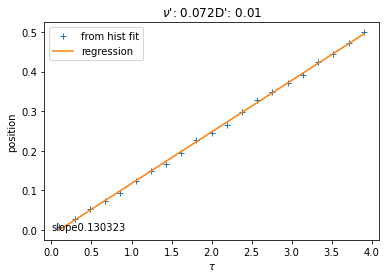

<ipython-input-8-913dec42f73d>:28: RuntimeWarning: overflow encountered in exp
  return a*numpy.exp(-(x-ave)**2/(2*sigma))


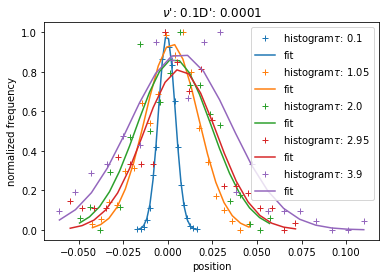

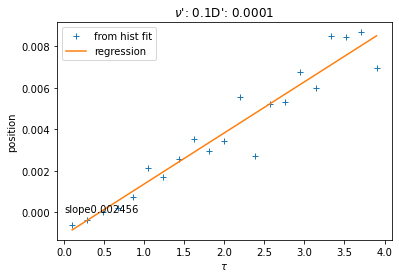

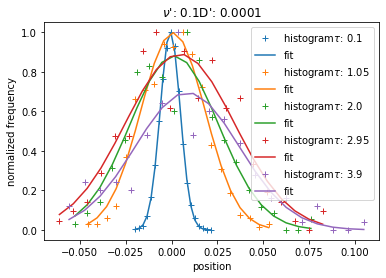

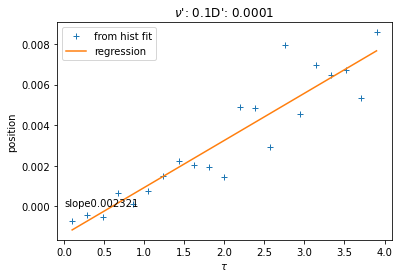

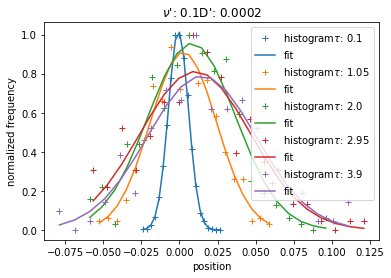

...

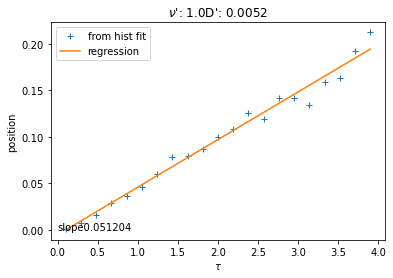

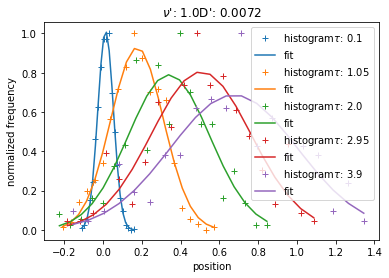

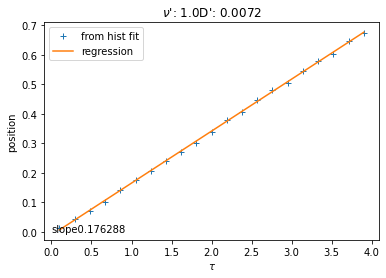

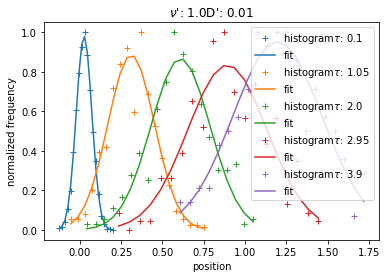

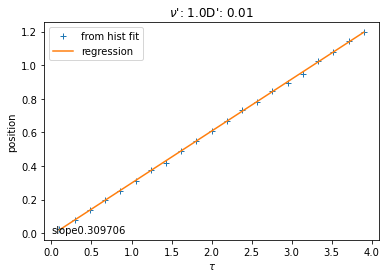

In [8]:
#fig, axs = plt.subplots(2,D_n,sharey="row",figsize = (16,15))
effsh0 = []
vsh0 = []
burnsh0 = []
for i in range(nu_n):
    effsh1 = []
    vsh1 = []
    burnsh1 = []
    for j in range(D_n): 
        burn_aves = []
        for k in range(run_n): 
            burn_aves.append(mean(array(sol_0Db[i][j][k][1]),axis=0))
        tmax = len(sol_0Db[i][j][0][0])
        taumax = tmax/5
        taus = array(range(10,int(taumax),int((taumax-10)/20)))
        delta_xs_tau = [] # save the dxs for each tau
        for n in taus:
            delta_xs = [] # save the dxs for all runs
            for l in range(run_n):
                xps = array(sol_0Db[i][j][l][0])
                if xps[-1] > 0.0:
                    delta_xs.extend(diff(xps[::(n+1)]))
                else:
                    delta_xs.extend(-diff(xps[::(n+1)]))
            delta_xs_tau.append(delta_xs)

        def gaus(x,a,ave,sigma):
            return a*numpy.exp(-(x-ave)**2/(2*sigma))

        def linear(x,m,b):
            return m*x + b
        colors = ["tab:blue", "tab:orange","tab:green","tab:red","tab:purple"]
        c= 0
        deltaX = []
        for l in range(len(delta_xs_tau)):
            x = histogram(delta_xs_tau[l],bins = 20)[1][:-1]
            y = histogram(delta_xs_tau[l],bins = 20)[0]
            normalizer = max(y)
            y = array(y)/normalizer
            

            a = 1
            ave = mean(x)
            sigma = mean((x-ave)**2)

            popt,pcov = curve_fit(gaus,x,y,p0=[a,ave,sigma])

            if l  % 5 == 0:
                
                plot(x,y,"+",label = "histogram"+ r"$\tau$: " +str(round(taus[l]*dt*10,4)),color = colors[c])
                plot(x,gaus(x,*popt), label = "fit",color = colors[c])
                title(r"$\nu$': "+ str(round(nus[i],4))+"D': "+ str(round(Ds[j],4)))
                ylabel("normalized frequency")
                xlabel("position")
                legend()
                c+=1
            aveX = popt[1]
            deltaX.append(aveX)
        show()
        tausT = array(taus)*10*dt
        poplin,plin = curve_fit(linear,tausT, deltaX, p0 = [1.0,0.0])
        plot(tausT,deltaX,"+",label = "from hist fit")
        plot(tausT, linear(tausT,*poplin),label = "regression")
        text(0,0, "slope"+str(round(poplin[0],6)) )
        ylabel("position")
        xlabel(r"$\tau$")
        title(r"$\nu$': "+ str(round(nus[i],4))+"D': "+ str(round(Ds[j],4)))
        legend()
        show()
        effsh1.append(1/Ds[j]*poplin[0]**2/mean(burn_aves))
        vsh1.append(poplin[0])
        burnsh1.append(mean(burn_aves))
    effsh0.append(effsh1)
    vsh0.append(vsh1)
    burnsh0.append(burnsh1)
effsh0 = array(effsh0)
vsh0 = array(vsh0)
burnsh0 = array(burnsh0)

### <x^2> vs. tau

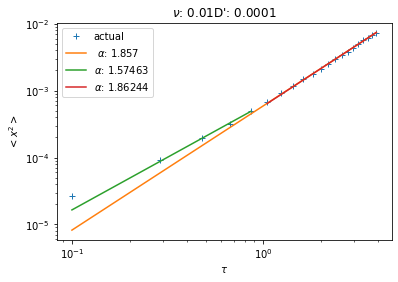

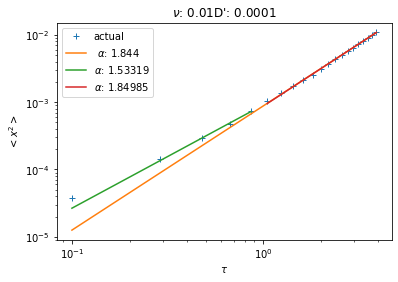

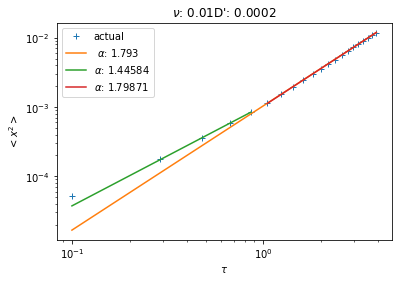

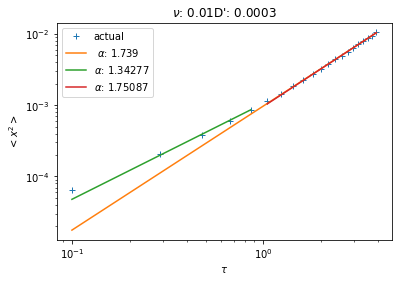

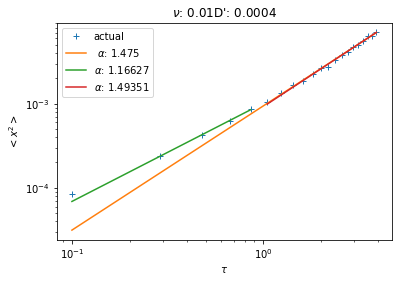

...

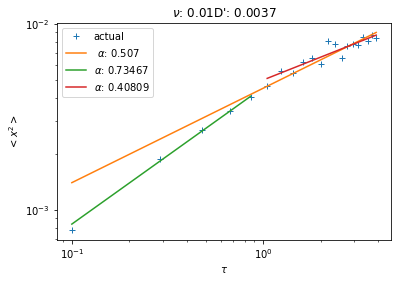

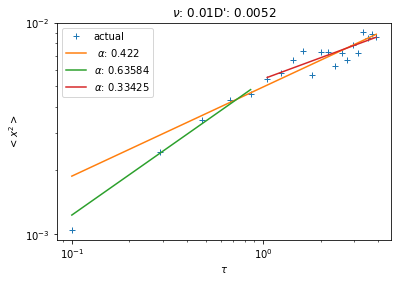

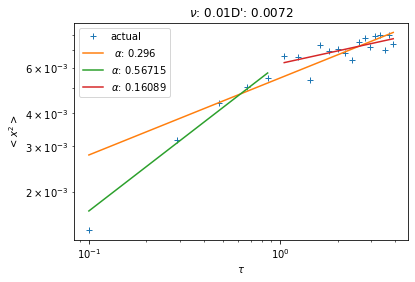

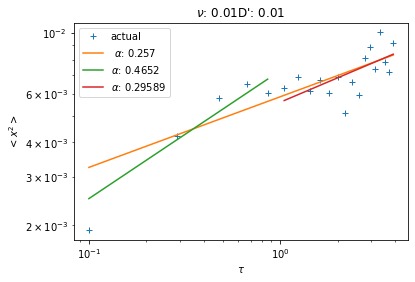

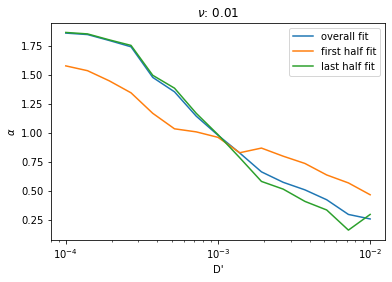

In [51]:
def alpha_exp(x,b,a):
    return b*x**a
sol = sol_0Db
alphas0 = []
alphas01 = []
alphas02 = []
for i in range(1):
    keep1 = []
    alphas1 = []
    alphas11 = []
    alphas12 = []
    for j in range(D_n):
        tmax = len(sol[i][j][0][0])
        taumax = tmax/5
        taus_n = 20
        taus = array(range(10,int(taumax),int((taumax-10)/taus_n)))
        x2_tau = []
        for n in taus:
            x2 = [] 
            for k in range(run_n):
                xps = array(sol[i][j][k][0])
                x2.extend(diff(xps[::(n+1)])**2)
            x2_tau.append(mean(x2))
        x = taus*10*dt
        y = x2_tau
        popt,popcov = curve_fit(alpha_exp,x,y,p0 = [1.0,1.0])

        cut = 5
        xa = x[:cut]
        ya = y[:cut]
        popt1,popcov = curve_fit(alpha_exp,xa,ya,p0 = [1.0,1.0])

        xb = x[cut:]
        yb = y[cut:]
        popt2,popcov = curve_fit(alpha_exp,xb,yb,p0 = [1.0,1.0])
        
        title(r"$\nu$: " +str(round(nus[i],3))+"D': "+str(round(Ds[j],4)))
        plot(x,y,"+",label ="actual")
        plot(x,alpha_exp(x,*popt),label = r" $\alpha$: "+str(round(popt[1],3)))
        plot(xa,alpha_exp(xa,*popt1),label = r"$\alpha$: "+str(round(popt1[1],5)))
        plot(xb,alpha_exp(xb,*popt2),label = r"$\alpha$: "+str(round(popt2[1],5)))
        ylabel(r"$<x^2>$")
        xlabel(r"$\tau$")
        yscale("log")
        xscale("log")
        legend()
        show()

        alphas1.append(popt[1])
        alphas11.append(popt1[1])
        alphas12.append(popt2[1])
    alphas0.append(alphas1)
    alphas01.append(alphas11)
    alphas02.append(alphas12)
    
    plot(Ds,alphas1, label = "overall fit")
    plot(Ds,alphas11,label = "first half fit")
    plot(Ds,alphas12,label = "last half fit")
    title(r"$\nu$: " +str(round(nus[i],3)))
    xscale("log")
    legend()
    ylabel(r"$\alpha$")
    xlabel("D'")
    show()

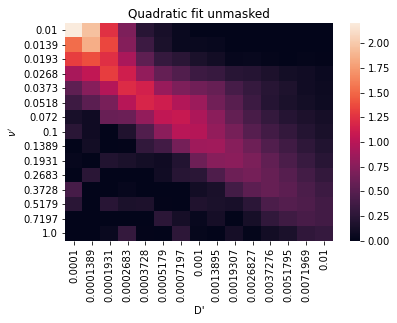

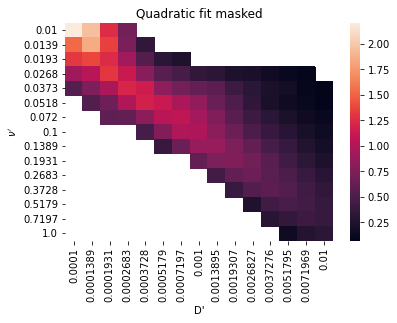

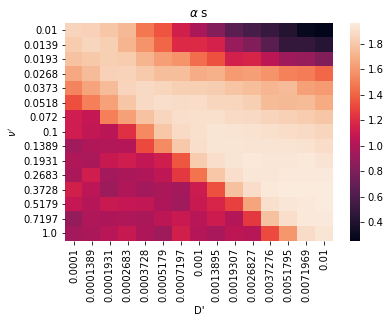

In [47]:
Dstmp = zeros(D_n)
for i in range(D_n):
    Dstmp[i] = round(Ds[i],7)
nustmp = zeros(nu_n)
for i in range(nu_n):
    nustmp[i] = round(nus[i],4)
keep0 = []
for i in range(nu_n):
    keep1 = []
    for j in range(D_n):
        if alphas0[i][j] > 1.5:
            keep1.append(False)
        else:
            keep1.append(True)
        if effsq0[i][j] < 0.0:
            effsq0[i][j] = 0.0
    keep0.append(keep1)
keep0 = array(keep0)
sb.heatmap(effsq0, xticklabels = Dstmp, yticklabels = nustmp)
ylabel(r"$\nu'$")
xlabel("D'")
title("Quadratic fit unmasked")
show()


sb.heatmap(effsq0, xticklabels = Dstmp, yticklabels = nustmp, mask = keep0)
ylabel(r"$\nu'$")
xlabel("D'")
title("Quadratic fit masked")
show()

sb.heatmap(alphas0, xticklabels = Dstmp, yticklabels = nustmp)
ylabel(r"$\nu'$")
xlabel("D'")
title(r"$\alpha$ s")
show()

Text(0.5, 1.0, 'Quadratic fit')

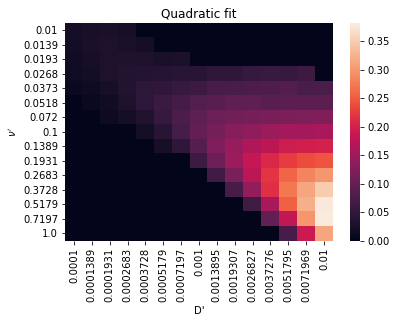

In [22]:
Dstmp = zeros(D_n)
for i in range(D_n):
    Dstmp[i] = round(Ds[i],7)
nustmp = zeros(nu_n)
for i in range(nu_n):
    nustmp[i] = round(nus[i],4)
for i in range(nu_n):
    for j in range(D_n):
        if vsq0[i][j] < 0.0:
            vsq0[i][j] = 0.0
sb.heatmap(vsq0*keep0, xticklabels = Dstmp, yticklabels = nustmp)
ylabel(r"$\nu'$")
xlabel("D'")
title("Quadratic fit")

(15, 15) (15,) (15,)


Text(0.5, 1.0, 'Histogram fit')

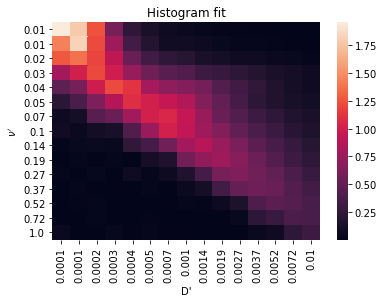

In [11]:
effsh0 = array(effsh0)
Dstmp = zeros(D_n)
for i in range(D_n):
    Dstmp[i] = round(Ds[i],4)
nustmp = zeros(nu_n)
for i in range(nu_n):
    nustmp[i] = round(nus[i],2)

print(effsh0.shape,nustmp.shape,Dstmp.shape)
sb.heatmap(effsh0, xticklabels = Dstmp, yticklabels = nustmp)
ylabel(r"$\nu'$")
xlabel("D'")
title("Histogram fit")

Text(0.5, 1.0, 'Histogram fit')

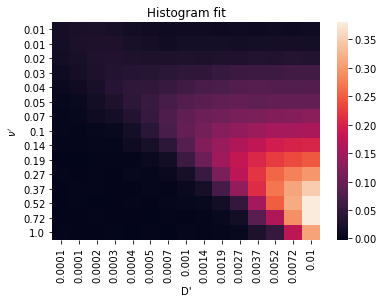

In [12]:
Dstmp = zeros(D_n)
for i in range(D_n):
    Dstmp[i] = round(Ds[i],4)
nustmp = zeros(nu_n)
for i in range(nu_n):
    nustmp[i] = round(nus[i],2)
sb.heatmap(vsh0, xticklabels = Dstmp, yticklabels = nustmp)
ylabel(r"$\nu'$")
xlabel("D'")
title("Histogram fit")

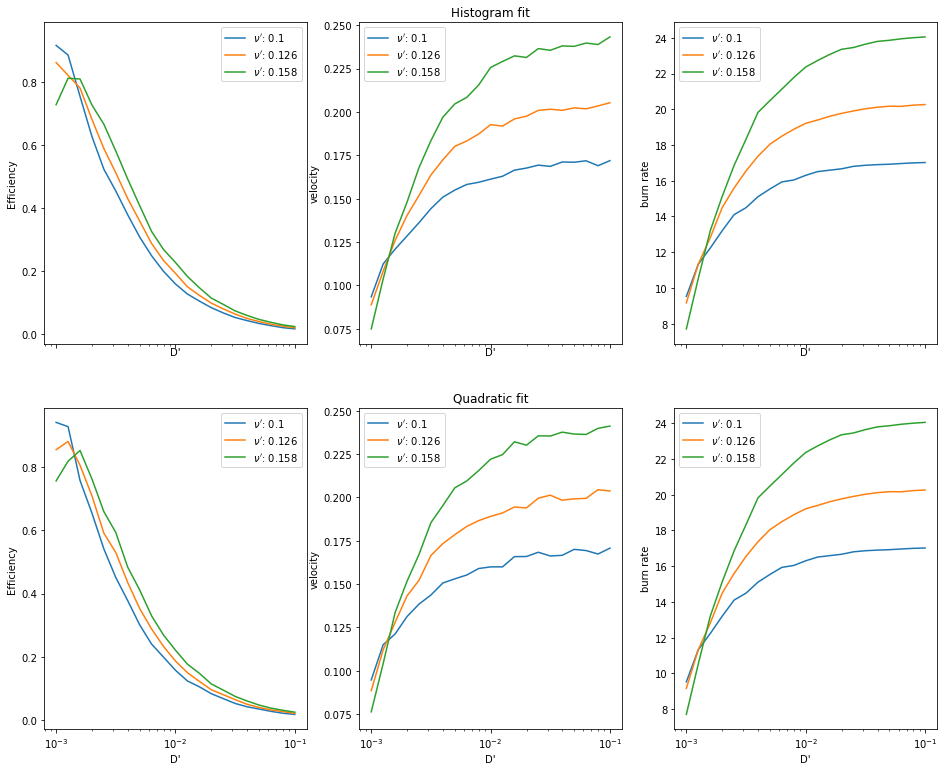

In [19]:
for i in range(nu_n):
    for j in range(D_n):
        if vsh0[i][j] <= 0.0:
            vsh0[i][j] = 0.0
        if vsq0[i][j] <= 0.0:
            vsq0[i][j] = 0.0
        
fig, axs = plt.subplots(2,3, sharex = "col", sharey = "col",figsize = (16,13))
for i in range(nu_n):
    if i in [0,1,2]:
        axs[0][0].set_ylabel("Efficiency")
        axs[0][1].set_ylabel("velocity")
        axs[0][2].set_ylabel("burn rate")
        axs[1][0].set_ylabel("Efficiency")
        axs[1][1].set_ylabel("velocity")
        axs[1][2].set_ylabel("burn rate")

        axs[0][0].set_xlabel("D'")
        axs[0][1].set_xlabel("D'")
        axs[0][2].set_xlabel("D'")
        axs[1][0].set_xlabel("D'")
        axs[1][1].set_xlabel("D'")
        axs[1][2].set_xlabel("D'")

        axs[1][0].set_xscale('log')
        axs[1][1].set_xscale('log')
        axs[1][2].set_xscale('log')


        axs[0][1].title.set_text("Histogram fit")
        axs[1][1].title.set_text("Quadratic fit")

        axs[0][0].plot(Ds,effsh0[i], label = r"$\nu'$: "+ str(round(nus[i],3)))
        axs[0][1].plot(Ds,vsh0[i], label = r"$\nu'$: "+str(round(nus[i],3)))
        axs[0][2].plot(Ds,burnsh0[i], label = r"$\nu'$: "+str(round(nus[i],3)))
        axs[1][0].plot(Ds,effsq0[i], label = r"$\nu'$: "+str(round(nus[i],3)))
        axs[1][1].plot(Ds,vsq0[i], label = r"$\nu'$: "+str(round(nus[i],3)))
        axs[1][2].plot(Ds,burnsq0[i], label = r"$\nu'$: "+str(round(nus[i],3)))


        axs[0][0].legend()
        axs[0][1].legend()
        axs[0][2].legend()
        axs[1][0].legend()
        axs[1][1].legend()
        axs[1][2].legend()
    

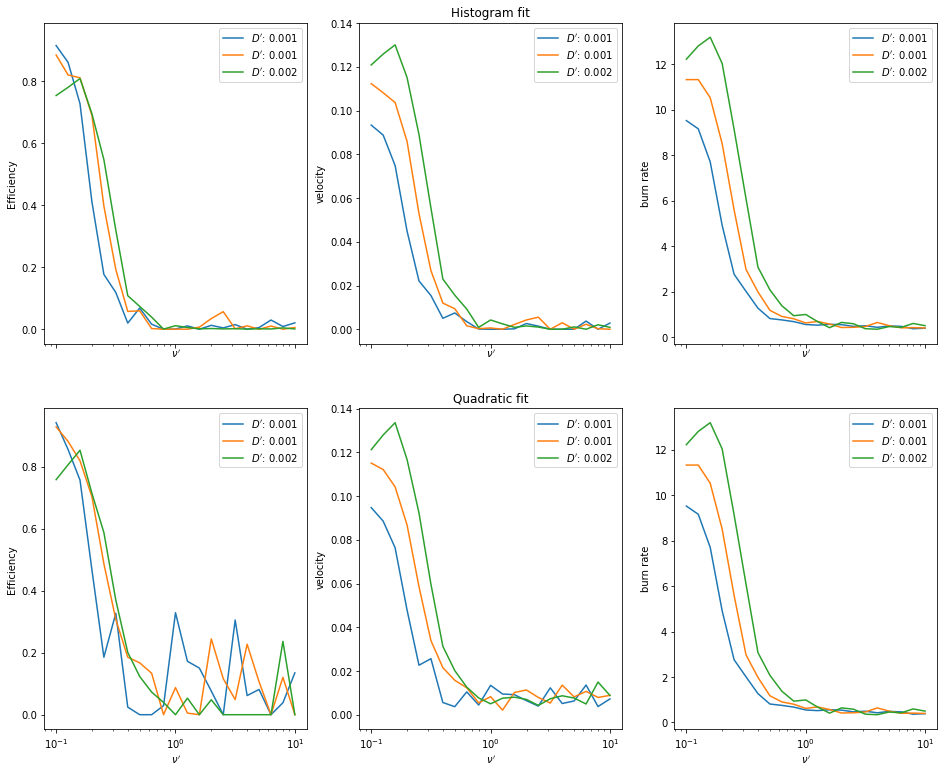

In [21]:
effsh0 = array(effsh0)
vsh0 = array(vsh0)
burnsh0 = array(burnsh0)
fig, axs = plt.subplots(2,3, sharex = "col", sharey = "col",figsize = (16,13))
for i in range(D_n):
    if i in [0,1,2]:
        axs[0][0].set_ylabel("Efficiency")
        axs[0][1].set_ylabel("velocity")
        axs[0][2].set_ylabel("burn rate")
        axs[1][0].set_ylabel("Efficiency")
        axs[1][1].set_ylabel("velocity")
        axs[1][2].set_ylabel("burn rate")

        axs[0][0].set_xlabel(r"$\nu'$")
        axs[0][1].set_xlabel(r"$\nu'$")
        axs[0][2].set_xlabel(r"$\nu'$")
        axs[1][0].set_xlabel(r"$\nu'$")
        axs[1][1].set_xlabel(r"$\nu'$")
        axs[1][2].set_xlabel(r"$\nu'$")

        axs[1][0].set_xscale('log')
        axs[1][1].set_xscale('log')
        axs[1][2].set_xscale('log')


        axs[0][1].title.set_text("Histogram fit")
        axs[1][1].title.set_text("Quadratic fit")

        axs[0][0].plot(nus,effsh0[:,i], label = r"$D'$: "+ str(round(Ds[i],3)))
        axs[0][1].plot(nus,vsh0[:,i], label = r"$D'$: "+str(round(Ds[i],3)))
        axs[0][2].plot(nus,burnsh0[:,i], label = r"$D'$: "+str(round(Ds[i],3)))
        axs[1][0].plot(nus,effsq0[:,i], label = r"$D'$: "+str(round(Ds[i],3)))
        axs[1][1].plot(nus,vsq0[:,i], label = r"$D'$: "+str(round(Ds[i],3)))
        axs[1][2].plot(nus,burnsq0[:,i], label = r"$D'$: "+str(round(Ds[i],3)))


        axs[0][0].legend()
        axs[0][1].legend()
        axs[0][2].legend()
        axs[1][0].legend()
        axs[1][1].legend()
        axs[1][2].legend()
    

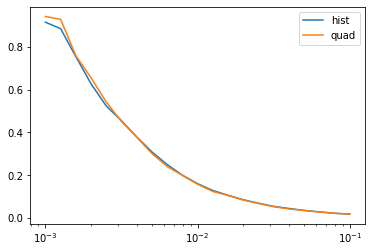

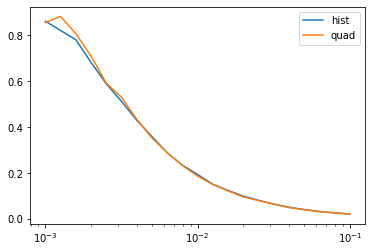

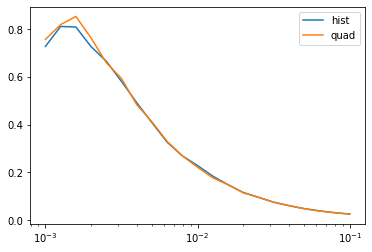

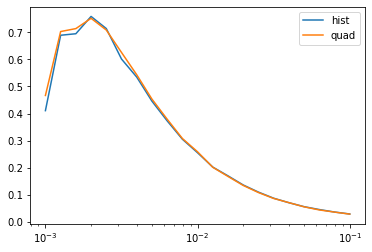

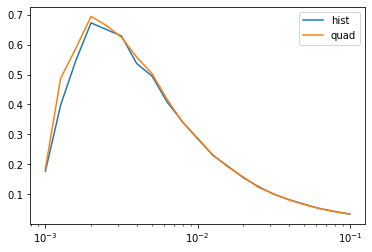

...

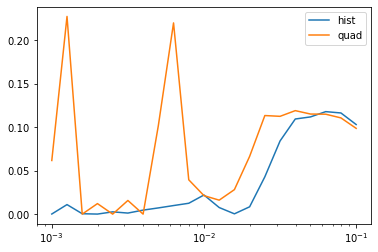

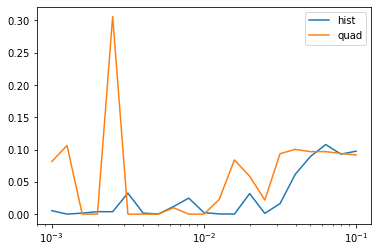

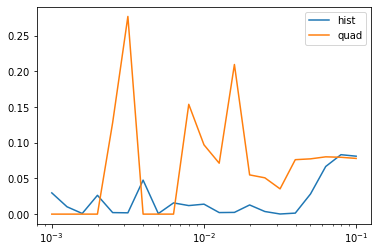

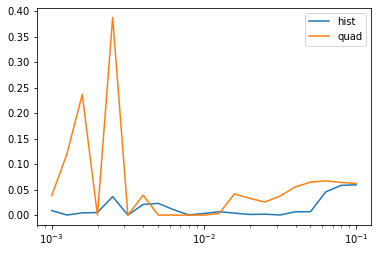

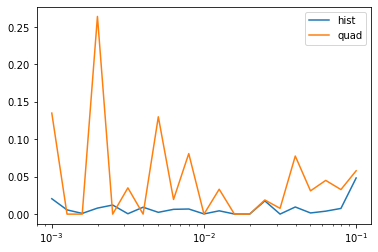

In [22]:
for i in range(nu_n):
    plot(Ds,effsh0[i], label = "hist")
    plot(Ds,effsq0[i], label = "quad")
    xscale('log')
    #yscale("log")
    legend()
    show()

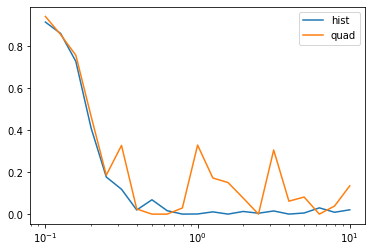

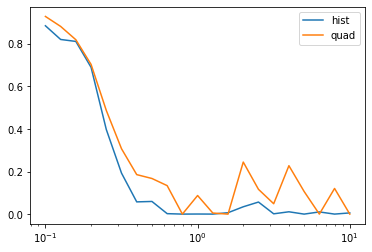

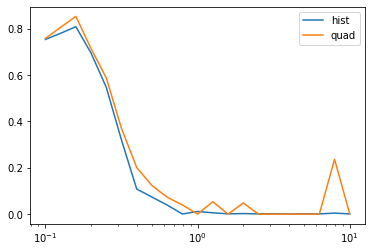

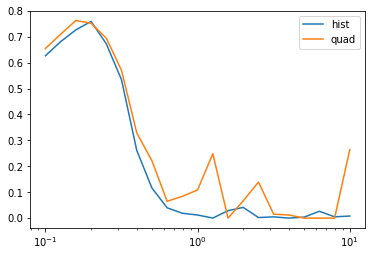

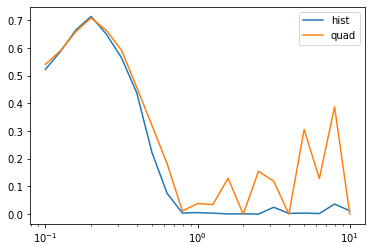

...

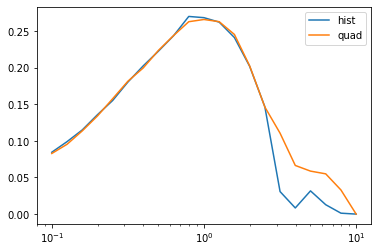

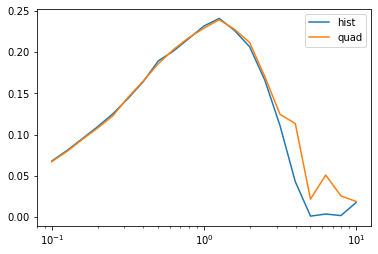

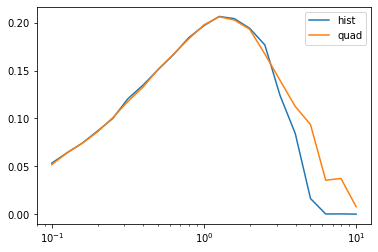

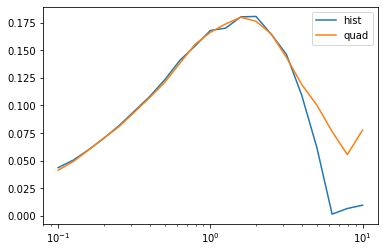

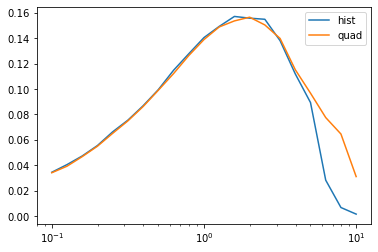

In [ ]:
for i in range(D_n):
    plot(nus,effsh0[:,i], label = "hist")
    plot(nus,effsq0[:,i], label = "quad")
    xscale('log')
    #yscale("log")
    legend()
    show()

In [ ]:
%pylab inline
from scipy.integrate import solve_ivp
from IPython import display
import time
import scipy.integrate as integrate
from scipy.optimize import curve_fit
import seaborn as sb

### Initializations

# the 1D space
length = 30.0
Lmax = length
Lmin = -length
dx = 0.1
Nx = int((Lmax-Lmin)/dx) +1
xs = linspace(Lmin, Lmax, Nx)

# will be used to determine atot (atot = N) when only D is specified  
# and used to determine D (D = atot/N) when only atot is specified
N = 100.0 

# the diffusion coefficients
Ds = logspace(-4,-1,10,base=10)
D_n = len(Ds)

nus = logspace(-2,1,10,base = 10)
nu_n = len(nus)

dt = 0.001
tf = 100.0 #each run goes for (tf/dt) steps 
run_n = 30 # number of runs

print(nus,Ds)

### Biased initial substrate 
#### efficiency vs. D (a0 = 1/sigma)

sol_0Db = []
for nu in nus:
    sol_1 = []
    for D in Ds: 
        sol_2 = []
        for run in range(run_n):
            xp = 0.0
            Ac = zeros(Nx) #initialize bound complex

            #intialize substrate
            As = zeros(Nx) 
            As[xs > 0.0] = linspace(0.1,length,int(Lmax/dx)) * N/2.0 # create initial gradient with slope (a0/2.0)
            As[xs > 2.0] = N # biased to the right

            # some values to save for each time step
            xp_t = [] # position
            v_t = [] # times
            burn_t = [] # burn rate

            noisescale = sqrt(2*dt*D) # the scale of diffusion
            t_max = int(tf/dt)
            for t in range(t_max): 

                total_f = D * trapz(-(xp -xs) * Ac, x=xs)
                binding = exp(-0.5 * (xp - xs) ** 2) * As
                burnt = nu * Ac
                Ac += (binding - burnt) *dt
                As += (- binding) * dt
                noise = noisescale* random.normal(0.0,1.0)

                xp += total_f * dt + noise # update position

                if t % 10.0 == 0.0: # save values
                    xp_t.append(xp)
                    v_t.append(total_f+noise/dt)
                    burn_t.append(trapz(Ac*nu,x=xs))

                if abs(xp) > length -5.0: # stop before it hits an edge
                    break


            plot(linspace(0,int((t+1)*dt),int(t/10+1)),xp_t)
            xlabel("time")
            ylabel("position")
            

            # save the mean velocity and burn rate for the run
            start_index = 2000
            sol_2.append([xp_t[-start_index:],burn_t[-start_index:]])
        text(0.0,0.0,r"$\nu'$: " +str(round(nu,4))+"  D: "+str(round(D,4)))
        show()
        # save these for each diffusion coefficient
        sol_1.append(sol_2)
    sol_0Db.append(sol_1)
display.clear_output(wait=True)

### Noisy unbiased initial substrate


sol_0Db = []
for nu in nus:
    sol_1 = []
    for D in Ds: 
        sol_2 = []
        for run in range(run_n):
            xp = 0.0
            Ac = zeros(Nx) #initialize bound complex

            #intialize substrate
            As = zeros(Nx) 
            As[xs>2.0] = (ones(int(Nx/2-20)) + 0.01*random.normal(0.0,1.0, size = int(Nx/2-20)))*N
            As[xs<-2.0] = (ones(int(Nx/2-20)) + 0.01*random.normal(0.0,1.0, size = int(Nx/2-20)))*N
            # some values to save for each time step
            xp_t = [] # position
            v_t = [] # times
            burn_t = [] # burn rate

            noisescale = sqrt(2*dt*D) # the scale of diffusion
            t_max = int(tf/dt)
            for t in range(t_max): 

                total_f = D * trapz(-(xp -xs) * Ac, x=xs)
                binding = exp(-0.5 * (xp - xs) ** 2) * As
                burnt = nu * Ac
                Ac += (binding - burnt) *dt
                As += (- binding) * dt
                noise = noisescale* random.normal(0.0,1.0)

                xp += total_f * dt + noise # update position

                if t % 10.0 == 0.0: # save values
                    xp_t.append(xp)
                    v_t.append(total_f+noise/dt)
                    burn_t.append(trapz(Ac*nu,x=xs))

                if abs(xp) > length -5.0: # stop before it hits an edge
                    break
                if t % 1000.0 == 0.0 and run == 200:
                    display.clear_output(wait=True)
                    cla()
                    plot(xs,As, label = "As")
                    plot(xs, Ac, label = "Ac")
                    legend()
                    display.display(gcf())

            
            plot(linspace(0,int((t+1)*dt),int(t/10+1)),xp_t)
            
            

            # save the mean velocity and burn rate for the run
            start_index = 2000
            sol_2.append([xp_t[-start_index:],burn_t[-start_index:]])
        text(0.0,0.0,r"$\nu'$: " +str(round(nu,4))+"  D: "+str(round(D,4)))
        show()
        # save these for each diffusion coefficient
        sol_1.append(sol_2)
    sol_0Db.append(sol_1)
display.clear_output(wait=True)

### Efficiency with quadratic fit

def quadratic(x,a,b):
    return a*x**2 + b*x 

effsq0 = []
vsq0 = []
burnsq0 = []
for i in range(nu_n):
    effsq1 = []
    vsq1 = []
    burnsq1 = []
    for j in range(D_n): # diffusion coefficients
        print(nus[i],Ds[j])
        tmax = len(sol_0Db[i][j][0][0])
        taumax = tmax/5
        taus = array(range(10,int(taumax),int((taumax-10)/20)))
        
        burn_aves = []
        for k in range(run_n):
            burn_aves.append(mean(array(sol_0Db[i][j][k][1]),axis=0))
        x2_tau = []
        for n in taus:
            x2 = [] 
            for l in range(run_n):
                xps = array(sol_0Db[i][j][l][0])
                x2.extend(diff(xps[::(n+1)])**2)
                
            x2_tau.append(mean(x2))
        x = taus*10*dt
        y = x2_tau
        popt,pcov = curve_fit(quadratic,x,y,p0=[1,1], bounds = ([0.0,0.0],[10.0,10.0]))
        
    
        title("D': "+str(round(Ds[j],4)))
        #title(r"$\nu'$: "+str(round(nus[i],3)))
        plot(x,y,"+",label ="actual")
        plot(x,quadratic(x,*popt),label = "fit")
        text(0,0,"v: "+str(round(sqrt(abs(popt[0])),6))+ "  D': "+str(round(popt[1]/2,6)))
        ylabel(r"$<x^2>$")
        xlabel(r"$\tau$")
        legend()
        show()
        eff = 1/Ds[j]*popt[0]/mean(burn_aves)
        effsq1.append(eff)
        vsq1.append(sqrt(abs(popt[0])))
        burnsq1.append(mean(burn_aves))
    effsq0.append(effsq1)
    vsq0.append(vsq1)
    burnsq0.append(burnsq1)
effsq0 = array(effsq0)
vsq0 = array(vsq0)
burnsq0 = array(burnsq0)

    

### efficiency with histogram fit

#fig, axs = plt.subplots(2,D_n,sharey="row",figsize = (16,15))
effsh0 = []
vsh0 = []
burnsh0 = []
for i in range(nu_n):
    effsh1 = []
    vsh1 = []
    burnsh1 = []
    for j in range(D_n): 
        burn_aves = []
        for k in range(run_n): 
            burn_aves.append(mean(array(sol_0Db[i][j][k][1]),axis=0))
        tmax = len(sol_0Db[i][j][0][0])
        taumax = tmax/5
        taus = array(range(10,int(taumax),int((taumax-10)/20)))
        delta_xs_tau = [] # save the dxs for each tau
        for n in taus:
            delta_xs = [] # save the dxs for all runs
            for l in range(run_n):
                xps = array(sol_0Db[i][j][l][0])
                if xps[-1] > 0.0:
                    delta_xs.extend(diff(xps[::(n+1)]))
                else:
                    delta_xs.extend(-diff(xps[::(n+1)]))
            delta_xs_tau.append(delta_xs)

        def gaus(x,a,ave,sigma):
            return a*numpy.exp(-(x-ave)**2/(2*sigma))

        def linear(x,m,b):
            return m*x + b
        colors = ["tab:blue", "tab:orange","tab:green","tab:red","tab:purple"]
        c= 0
        deltaX = []
        for l in range(len(delta_xs_tau)):
            x = histogram(delta_xs_tau[l],bins = 20)[1][:-1]
            y = histogram(delta_xs_tau[l],bins = 20)[0]
            normalizer = max(y)
            y = array(y)/normalizer
            

            a = 1
            ave = mean(x)
            sigma = mean((x-ave)**2)

            popt,pcov = curve_fit(gaus,x,y,p0=[a,ave,sigma])

            if l  % 5 == 0:
                
                plot(x,y,"+",label = "histogram"+ r"$\tau$: " +str(round(taus[l]*dt*10,4)),color = colors[c])
                plot(x,gaus(x,*popt), label = "fit",color = colors[c])
                title(r"$\nu$': "+ str(round(nus[i],4))+"D': "+ str(round(Ds[j],4)))
                ylabel("normalized frequency")
                xlabel("position")
                legend()
                c+=1
            aveX = popt[1]
            deltaX.append(aveX)
        show()
        tausT = array(taus)*10*dt
        poplin,plin = curve_fit(linear,tausT, deltaX, p0 = [1.0,0.0])
        plot(tausT,deltaX,"+",label = "from hist fit")
        plot(tausT, linear(tausT,*poplin),label = "regression")
        text(0,0, "slope"+str(round(poplin[0],6)) )
        ylabel("position")
        xlabel(r"$\tau$")
        title(r"$\nu$': "+ str(round(nus[i],4))+"D': "+ str(round(Ds[j],4)))
        legend()
        show()
        effsh1.append(1/Ds[j]*poplin[0]**2/mean(burn_aves))
        vsh1.append(poplin[0])
        burnsh1.append(mean(burn_aves))
    effsh0.append(effsh1)
    vsh0.append(vsh1)
    burnsh0.append(burnsh1)
effsh0 = array(effsh0)
vsh0 = array(vsh0)
burnsh0 = array(burnsh0)

Dstmp = zeros(D_n)
for i in range(D_n):
    Dstmp[i] = round(Ds[i],7)
nustmp = zeros(nu_n)
for i in range(nu_n):
    nustmp[i] = round(nus[i],4)
for i in range(nu_n):
    for j in range(D_n):
        if effsq0[i][j] < 0.0:
            effsq0[i][j] = 0.0
sb.heatmap(effsq0, xticklabels = Dstmp, yticklabels = nustmp)
ylabel(r"$\nu'$")
xlabel("D'")
title("Quadratic fit")

Dstmp = zeros(D_n)
for i in range(D_n):
    Dstmp[i] = round(Ds[i],7)
nustmp = zeros(nu_n)
for i in range(nu_n):
    nustmp[i] = round(nus[i],4)
for i in range(nu_n):
    for j in range(D_n):
        if vsq0[i][j] < 0.0:
            vsq0[i][j] = 0.0
sb.heatmap(vsq0, xticklabels = Dstmp, yticklabels = nustmp)
ylabel(r"$\nu'$")
xlabel("D'")
title("Quadratic fit")

effsh0 = array(effsh0)
Dstmp = zeros(D_n)
for i in range(D_n):
    Dstmp[i] = round(Ds[i],4)
nustmp = zeros(nu_n)
for i in range(nu_n):
    nustmp[i] = round(nus[i],2)

print(effsh0.shape,nustmp.shape,Dstmp.shape)
sb.heatmap(effsh0, xticklabels = Dstmp, yticklabels = nustmp)
ylabel(r"$\nu'$")
xlabel("D'")
title("Histogram fit")

Dstmp = zeros(D_n)
for i in range(D_n):
    Dstmp[i] = round(Ds[i],4)
nustmp = zeros(nu_n)
for i in range(nu_n):
    nustmp[i] = round(nus[i],2)
sb.heatmap(vsh0, xticklabels = Dstmp, yticklabels = nustmp)
ylabel(r"$\nu'$")
xlabel("D'")
title("Histogram fit")

for i in range(nu_n):
    for j in range(D_n):
        if vsh0[i][j] <= 0.0:
            vsh0[i][j] = 0.0
        if vsq0[i][j] <= 0.0:
            vsq0[i][j] = 0.0
        
fig, axs = plt.subplots(2,3, sharex = "col", sharey = "col",figsize = (16,13))
for i in range(nu_n):
    if i in [8,9,10]:
        axs[0][0].set_ylabel("Efficiency")
        axs[0][1].set_ylabel("velocity")
        axs[0][2].set_ylabel("burn rate")
        axs[1][0].set_ylabel("Efficiency")
        axs[1][1].set_ylabel("velocity")
        axs[1][2].set_ylabel("burn rate")

        axs[0][0].set_xlabel("D'")
        axs[0][1].set_xlabel("D'")
        axs[0][2].set_xlabel("D'")
        axs[1][0].set_xlabel("D'")
        axs[1][1].set_xlabel("D'")
        axs[1][2].set_xlabel("D'")

        axs[1][0].set_xscale('log')
        axs[1][1].set_xscale('log')
        axs[1][2].set_xscale('log')


        axs[0][1].title.set_text("Histogram fit")
        axs[1][1].title.set_text("Quadratic fit")

        axs[0][0].plot(Ds,effsh0[i], label = r"$\nu'$: "+ str(round(nus[i],3)))
        axs[0][1].plot(Ds,vsh0[i], label = r"$\nu'$: "+str(round(nus[i],3)))
        axs[0][2].plot(Ds,burnsh0[i], label = r"$\nu'$: "+str(round(nus[i],3)))
        axs[1][0].plot(Ds,effsq0[i], label = r"$\nu'$: "+str(round(nus[i],3)))
        axs[1][1].plot(Ds,vsq0[i], label = r"$\nu'$: "+str(round(nus[i],3)))
        axs[1][2].plot(Ds,burnsq0[i], label = r"$\nu'$: "+str(round(nus[i],3)))


        axs[0][0].legend()
        axs[0][1].legend()
        axs[0][2].legend()
        axs[1][0].legend()
        axs[1][1].legend()
        axs[1][2].legend()
    

effsh0 = array(effsh0)
vsh0 = array(vsh0)
burnsh0 = array(burnsh0)
fig, axs = plt.subplots(2,3, sharex = "col", sharey = "col",figsize = (16,13))
for i in range(D_n):
    if i in [8,9,10]:
        axs[0][0].set_ylabel("Efficiency")
        axs[0][1].set_ylabel("velocity")
        axs[0][2].set_ylabel("burn rate")
        axs[1][0].set_ylabel("Efficiency")
        axs[1][1].set_ylabel("velocity")
        axs[1][2].set_ylabel("burn rate")

        axs[0][0].set_xlabel(r"$\nu'$")
        axs[0][1].set_xlabel(r"$\nu'$")
        axs[0][2].set_xlabel(r"$\nu'$")
        axs[1][0].set_xlabel(r"$\nu'$")
        axs[1][1].set_xlabel(r"$\nu'$")
        axs[1][2].set_xlabel(r"$\nu'$")

        axs[1][0].set_xscale('log')
        axs[1][1].set_xscale('log')
        axs[1][2].set_xscale('log')


        axs[0][1].title.set_text("Histogram fit")
        axs[1][1].title.set_text("Quadratic fit")

        axs[0][0].plot(Ds,effsh0[:,i], label = r"$D'$: "+ str(round(Ds[i],3)))
        axs[0][1].plot(Ds,vsh0[:,i], label = r"$D'$: "+str(round(Ds[i],3)))
        axs[0][2].plot(Ds,burnsh0[:,i], label = r"$D'$: "+str(round(Ds[i],3)))
        axs[1][0].plot(Ds,effsq0[:,i], label = r"$D'$: "+str(round(Ds[i],3)))
        axs[1][1].plot(Ds,vsq0[:,i], label = r"$D'$: "+str(round(Ds[i],3)))
        axs[1][2].plot(Ds,burnsq0[:,i], label = r"$D'$: "+str(round(Ds[i],3)))


        axs[0][0].legend()
        axs[0][1].legend()
        axs[0][2].legend()
        axs[1][0].legend()
        axs[1][1].legend()
        axs[1][2].legend()
    

for i in range(nu_n):
    plot(Ds,effsh0[i], label = "hist")
    plot(Ds,effsq0[i], label = "quad")
    xscale('log')
    #yscale("log")
    legend()
    show()

for i in range(D_n):
    plot(nus,effsh0[:,i], label = "hist")
    plot(nus,effsq0[:,i], label = "quad")
    xscale('log')
    #yscale("log")
    legend()
    show()

